In [ ]:
!pip install pillow

In [4]:
pip install albumentations --user


  Using cached albumentations-2.0.8-py3-none-any.whl.metadata (43 kB)
  Using cached pydantic-2.11.7-py3-none-any.whl.metadata (67 kB)
  Using cached albucore-0.0.24-py3-none-any.whl.metadata (5.3 kB)
  Using cached opencv_python_headless-4.11.0.86-cp37-abi3-win_amd64.whl.metadata (20 kB)
  Using cached annotated_types-0.7.0-py3-none-any.whl.metadata (15 kB)
Using cached albumentations-2.0.8-py3-none-any.whl (369 kB)
Using cached albucore-0.0.24-py3-none-any.whl (15 kB)
Using cached opencv_python_headless-4.11.0.86-cp37-abi3-win_amd64.whl (39.4 MB)
Using cached pydantic-2.11.7-py3-none-any.whl (444 kB)
Using cached annotated_types-0.7.0-py3-none-any.whl (13 kB)

   ---------------------------------------- 0/5 [opencv-python-headless]
   ---------------------------------------- 0/5 [opencv-python-headless]
   ---------------------------------------- 0/5 [opencv-python-headless]
   ---------------------------------------- 0/5 [opencv-python-headless]
   ----------------------------------

In [3]:
pip install imblearn

   ---------------------------------------- 0.0/11.1 MB ? eta -:--:--
    --------------------------------------- 0.3/11.1 MB ? eta -:--:--
   -- ------------------------------------- 0.8/11.1 MB 2.1 MB/s eta 0:00:05
   ---- ----------------------------------- 1.3/11.1 MB 2.4 MB/s eta 0:00:05
   ------ --------------------------------- 1.8/11.1 MB 2.6 MB/s eta 0:00:04
   --------- ------------------------------ 2.6/11.1 MB 2.7 MB/s eta 0:00:04
   ------------ --------------------------- 3.4/11.1 MB 2.9 MB/s eta 0:00:03
   -------------- ------------------------- 3.9/11.1 MB 2.9 MB/s eta 0:00:03
   --------------- ------------------------ 4.2/11.1 MB 2.9 MB/s eta 0:00:03
   ---------------- ----------------------- 4.5/11.1 MB 2.6 MB/s eta 0:00:03
   ------------------ --------------------- 5.2/11.1 MB 2.6 MB/s eta 0:00:03
   -------------------- ------------------- 5.8/11.1 MB 2.6 MB/s eta 0:00:03
   ----------------------- ---------------- 6.6/11.1 MB 2.7 MB/s eta 0:00:02
   ----------

  You can safely remove it manually.


Importing libraries

In [1]:
import os
import albumentations as A
import tensorflow as tf
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import BinaryCrossentropy
from sklearn.metrics import precision_score, recall_score, f1_score, average_precision_score, confusion_matrix, roc_curve, auc
from sklearn.model_selection import train_test_split, StratifiedKFold
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

# Configurações de seed para reprodutibilidade
np.random.seed(42)
tf.random.set_seed(42)

This code loads all images from folders, resizes and normalizes them, and gives you image data and class labels ready for model training.

In [2]:
def load_and_preprocess_images(data_dir, target_size=(224, 224)):
    images = []
    labels = []
    classes = os.listdir(data_dir)
    for label, class_name in enumerate(classes):
        class_path = os.path.join(data_dir, class_name)
        if os.path.isdir(class_path):
            for img_name in os.listdir(class_path):
                img_path = os.path.join(class_path, img_name)
                img = cv2.imread(img_path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, target_size)
                img = img / 255.0  # Normalização
                images.append(img)
                labels.append(label)
    return np.array(images), np.array(labels)

# Diretório de dados
data_dir = "D:\dataset_initial"
X, y = load_and_preprocess_images(data_dir)

Splitting the data 70% for training and 15% for testing, 15% for validation

In [4]:
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

In [5]:
X_train_flat = X_train.reshape(X_train.shape[0], -1)
undersampler = RandomUnderSampler(random_state=42)
X_train_under, y_train_under = undersampler.fit_resample(X_train_flat, y_train)

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_under, y_train_under)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)

Data augmentation : for each original image 3 more aumented images are created
SMOTE will chose the dataset with less images,sso negative is 142 so now 
positives -> 4* 147 = 588
negatives -> 4*147 = 588
total = 1176


In [6]:
augmentation_pipeline = A.Compose([
    A.Rotate(limit=15, p=0.7),
    A.RandomBrightnessContrast(p=0.5),
    A.GaussianBlur(p=0.3),
    A.GridDistortion(p=0.3),
    A.CLAHE(p=0.2),
    A.RandomScale(scale_limit=0.1, p=0.5),
    A.Perspective(p=0.3)
])
def augment_images(images, labels, augmentation_pipeline, augmentation_factor=3):
    augmented_images = []
    augmented_labels = []
    for img, label in zip(images, labels):
        augmented_images.append(img)
        augmented_labels.append(label)
        for _ in range(augmentation_factor):
            img_bgr = cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_RGB2BGR)
            augmented = augmentation_pipeline(image=img_bgr)['image']
            augmented_rgb = cv2.cvtColor(augmented, cv2.COLOR_BGR2RGB) / 255.0
            if augmented_rgb.shape == (224, 224, 3):
                augmented_images.append(augmented_rgb)
                augmented_labels.append(label)
    return np.array(augmented_images), np.array(augmented_labels)

X_train_aug, y_train_aug = augment_images(X_train_resampled, y_train_resampled, augmentation_pipeline)

In [7]:
def create_model():
    base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    for layer in base_model.layers[:-150]:
        layer.trainable = False
    model = tf.keras.Sequential([
        base_model,
        GlobalAveragePooling2D(),
        Dense(1024, activation='relu', kernel_regularizer=l2(0.002)),
        BatchNormalization(),
        Dropout(0.5),
        Dense(512, activation='relu', kernel_regularizer=l2(0.003)),
        BatchNormalization(),
        Dropout(0.4),
        Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid')
    ])
    return model

You're training your model 5 times, each time using a different part of the data for validation.
This helps you check if your model performs consistently and avoids overfitting to just one train/val split.

In [8]:
# Configuração de parâmetros para o treinamento
batch_size = 32
epochs = 15
k_folds = 5

# Inicializar StratifiedKFold
skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

# Armazenar métricas de cada fold
fold_metrics = []

# K-Fold Cross Validation
for fold, (train_idx, val_idx) in enumerate(skf.split(X_train_aug, y_train_aug)):
    print(f"Treinando Fold {fold + 1}/{k_folds}")
    
    # Divisão dos dados em treino e validação para o fold atual
    X_train_fold, X_val_fold = X_train_aug[train_idx], X_train_aug[val_idx]
    y_train_fold, y_val_fold = y_train_aug[train_idx], y_train_aug[val_idx]

    # Criação do modelo
    model = create_model()
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss=BinaryCrossentropy(),
        metrics=['accuracy']
    )
    
    # Treinamento
    history = model.fit(
        X_train_fold, y_train_fold,
        validation_data=(X_val_fold, y_val_fold),
        batch_size=batch_size,
        epochs=epochs,
        verbose=1
    )
    
    # Avaliação no conjunto de validação
    val_loss, val_accuracy = model.evaluate(X_val_fold, y_val_fold, verbose=0)
    print(f"Fold {fold + 1}: Loss = {val_loss:.4f}, Accuracy = {val_accuracy:.4f}")

    # Salvar métricas
    fold_metrics.append({
        'fold': fold + 1,
        'val_loss': val_loss,
        'val_accuracy': val_accuracy
    })


Treinando Fold 1/5
Epoch 1/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 206s 9s/step - accuracy: 0.5568 - loss: 5.2357 - val_accuracy: 0.5143 - val_loss: 5.0464
Epoch 2/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 99s 7s/step - accuracy: 0.7778 - loss: 4.8725 - val_accuracy: 0.6667 - val_loss: 4.9048
Epoch 3/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 97s 7s/step - accuracy: 0.8239 - loss: 4.6577 - val_accuracy: 0.7714 - val_loss: 4.7942
Epoch 4/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 88s 6s/step - accuracy: 0.8547 - loss: 4.5755 - val_accuracy: 0.8000 - val_loss: 4.6973
Epoch 5/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 92s 7s/step - accuracy: 0.9237 - loss: 4.3902 - val_accuracy: 0.8000 - val_loss: 4.6058
Epoch 6/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 93s 7s/step - accuracy: 0.8575 - loss: 4.4135 - val_accuracy: 0.8190 - val_loss: 4.5255
Epoch 7/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 106s 8s/step - accuracy: 0.8905 - loss: 4.3202 - val_accuracy: 0.8381 - val_loss: 4.4607
Epoch 8/15
14/14 ━━━━━━━━━━━━━━━━━━━━ 123s 9s/step - accuracy: 0.9319 - loss: 4.1852 - val_accura

metrics

In [9]:
# Previsões no conjunto de teste
y_pred = model.predict(X_test)
y_pred_classes = (y_pred > 0.5).astype(int)

# Cálculo de métricas
precision = precision_score(y_test, y_pred_classes)
recall = recall_score(y_test, y_pred_classes)
f1 = f1_score(y_test, y_pred_classes)
average_precision = average_precision_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Exibição das métricas
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Average Precision: {average_precision:.4f}")
print("Confusion Matrix:")
print(conf_matrix)

3/3 ━━━━━━━━━━━━━━━━━━━━ 51s 6s/step
Precision: 0.9818
Recall: 0.8438
F1 Score: 0.9076
Average Precision: 0.9863
Confusion Matrix:
[[21  1]
 [10 54]]


In [10]:
model.save("model_fold5.h5")


In [11]:
import datetime
timestamp = datetime.datetime.now().strftime("%Y%m%d_%H%M%S")
model.save(f"model_fold5_{timestamp}.h5")


In [12]:

model.save("D:\model_fold5.h5")


In [1]:
from tensorflow.keras.models import load_model

model = load_model(r"D:\model_fold5.h5")

It is drawing a ROC Curve (Receiver Operating Characteristic curve) to show how well your model separates the two classes — positive and negative.



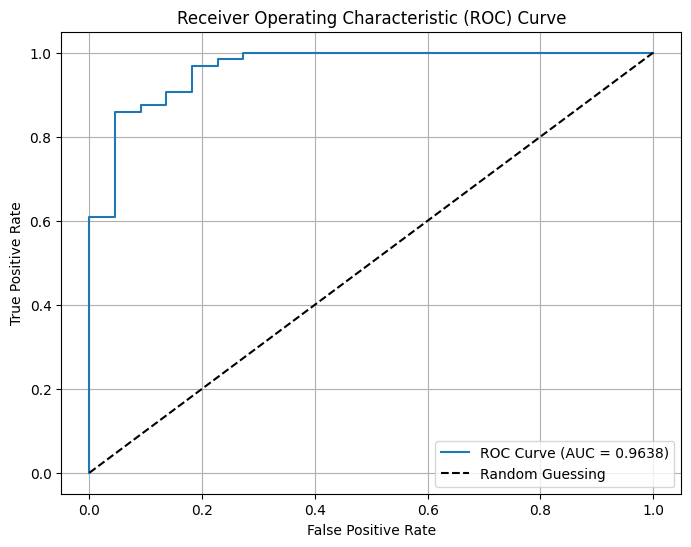

In [14]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt


# Curva ROC
fpr, tpr, thresholds = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"ROC Curve (AUC = {roc_auc:.4f})")
plt.plot([0, 1], [0, 1], 'k--', label="Random Guessing")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Receiver Operating Characteristic (ROC) Curve")
plt.legend()
plt.grid()
plt.show()

That steep line from (0.0, 0.0) to around (0.0, 0.8) means:Your model can find 80% of sickle cells while making almost zero mistakes on normal cells.

In Simple Terms

X stays at 0.0 = Not calling any normal cells "sickle cell" by mistake
Y goes up to 0.8 = Finding 8 out of 10 sickle cells correctly

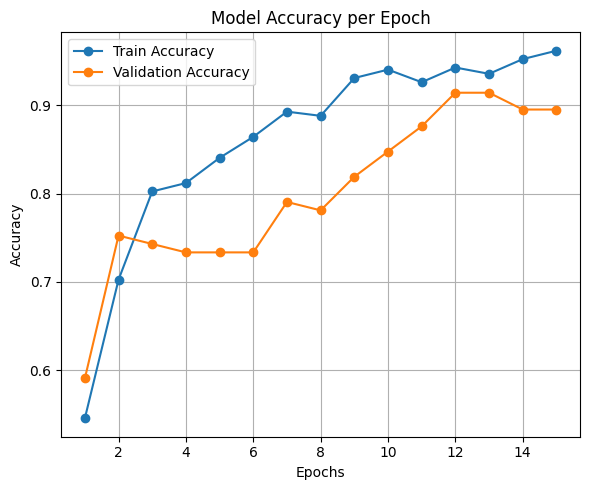

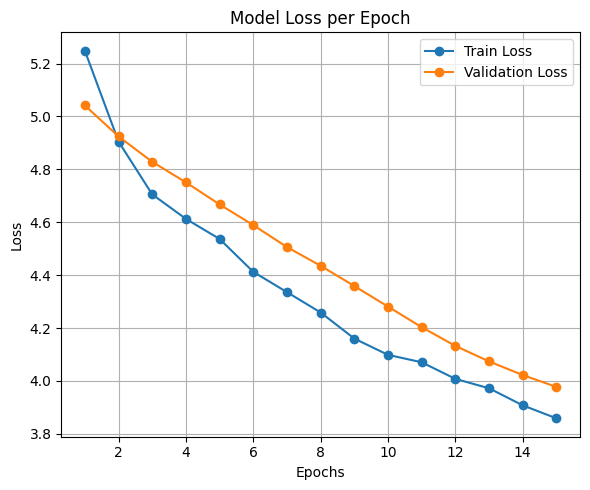

In [21]:
import matplotlib.pyplot as plt

# Extract values from training history
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
train_loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(train_accuracy) + 1)

# Plot Accuracy
plt.figure(figsize=(6, 5))
plt.plot(epochs, train_accuracy, label='Train Accuracy', marker='o')
plt.plot(epochs, val_accuracy, label='Validation Accuracy', marker='o')
plt.title('Model Accuracy per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot Loss
plt.figure(figsize=(6, 5))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
plt.title('Model Loss per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 19s 19s/step


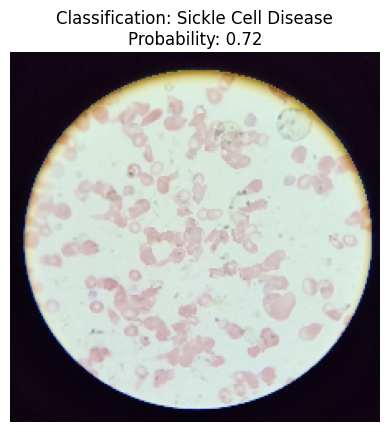

In [22]:
from tensorflow.keras.utils import load_img, img_to_array
import numpy as np
import matplotlib.pyplot as plt

# Caminho para a imagem individual
image_path = "D:\dataset_initial\Positives\\1.jpg"

# Carregar a imagem no tamanho esperado pelo modelo (224x224)
img = load_img(image_path, target_size=(224, 224))
img_array = img_to_array(img)

# Normalizar os valores da imagem (entre 0 e 1)
img_array = img_array / 255.0

# Adicionar dimensão extra para simular um lote de tamanho 1
img_array = np.expand_dims(img_array, axis=0)

prediction = model.predict(img_array)



# Exibir a imagem com a classificação
plt.imshow(img)
plt.title(f"Classification: {'Sickle Cell Disease' if prediction[0] > 0.5 else 'Healthy'}\nProbability: {prediction[0][0]:.2f}")
plt.axis("off")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


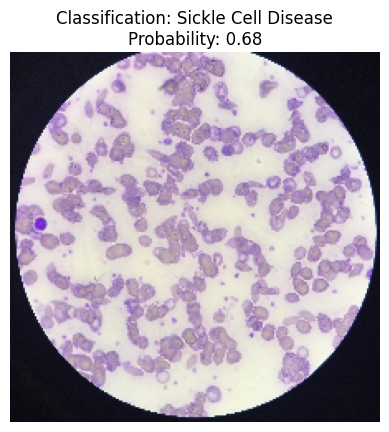

In [ ]:

from tensorflow.keras.utils import load_img, img_to_array
import numpy as np
import matplotlib.pyplot as plt

# Caminho para a imagem individual
image_path = "D:\\dataset_initial\\Positives\\29.jpg"

# Carregar a imagem no tamanho esperado pelo modelo (224x224)
img = load_img(image_path, target_size=(224, 224))
img_array = img_to_array(img)

# Normalizar os valores da imagem (entre 0 e 1)
img_array = img_array / 255.0

# Adicionar dimensão extra para simular um lote de tamanho 1
img_array = np.expand_dims(img_array, axis=0)

prediction = model.predict(img_array)



# Exibir a imagem com a classificação
plt.imshow(img)
plt.title(f"Classification: {'Sickle Cell Disease' if prediction[0] > 0.5 else 'Healthy'}\nProbability: {prediction[0][0]:.2f}")
plt.axis("off")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


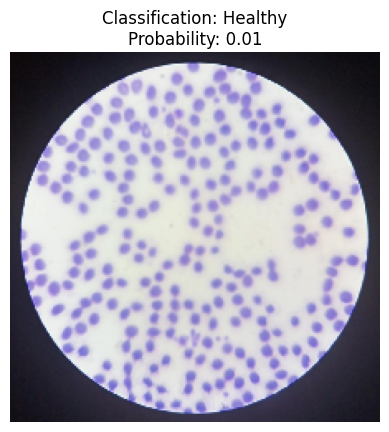

In [24]:


from tensorflow.keras.utils import load_img, img_to_array
import numpy as np
import matplotlib.pyplot as plt

# Caminho para a imagem individual
image_path = "D:\\dataset_initial\\Negatives\\N_3.jpg"

# Carregar a imagem no tamanho esperado pelo modelo (224x224)
img = load_img(image_path, target_size=(224, 224))
img_array = img_to_array(img)

# Normalizar os valores da imagem (entre 0 e 1)
img_array = img_array / 255.0

# Adicionar dimensão extra para simular um lote de tamanho 1
img_array = np.expand_dims(img_array, axis=0)

prediction = model.predict(img_array)



# Exibir a imagem com a classificação
plt.imshow(img)
plt.title(f"Classification: {'Sickle Cell Disease' if prediction[0] > 0.5 else 'Healthy'}\nProbability: {prediction[0][0]:.2f}")
plt.axis("off")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


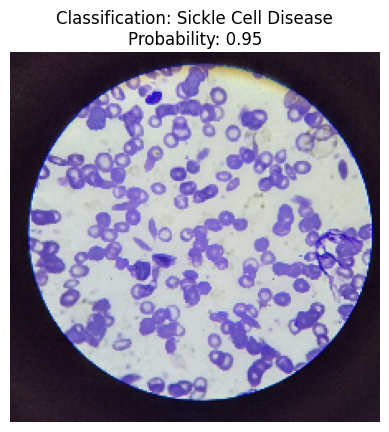

In [62]:


from tensorflow.keras.utils import load_img, img_to_array
import numpy as np
import matplotlib.pyplot as plt

# Caminho para a imagem individual
image_path = "D:\\dataset_initial\\Positives\\3.jpg"

# Carregar a imagem no tamanho esperado pelo modelo (224x224)
img = load_img(image_path, target_size=(224, 224))
img_array = img_to_array(img)

# Normalizar os valores da imagem (entre 0 e 1)
img_array = img_array / 255.0

# Adicionar dimensão extra para simular um lote de tamanho 1
img_array = np.expand_dims(img_array, axis=0)

prediction = model.predict(img_array)



# Exibir a imagem com a classificação
plt.imshow(img)
plt.title(f"Classification: {'Sickle Cell Disease' if prediction[0] > 0.5 else 'Healthy'}\nProbability: {prediction[0][0]:.2f}")
plt.axis("off")
plt.show()

In [26]:
pip install transformers torchvision gradio



  Using cached sniffio-1.3.1-py3-none-any.whl.metadata (3.9 kB)
   ---------------------------------------- 0.0/54.3 MB ? eta -:--:--
   ---------------------------------------- 0.3/54.3 MB ? eta -:--:--
   ---------------------------------------- 0.5/54.3 MB 1.1 MB/s eta 0:00:49
    --------------------------------------- 0.8/54.3 MB 1.4 MB/s eta 0:00:39
    --------------------------------------- 1.0/54.3 MB 1.4 MB/s eta 0:00:39
   - -------------------------------------- 1.6/54.3 MB 1.5 MB/s eta 0:00:36
   - -------------------------------------- 1.8/54.3 MB 1.5 MB/s eta 0:00:35
   - -------------------------------------- 2.4/54.3 MB 1.6 MB/s eta 0:00:32
   -- ------------------------------------- 2.9/54.3 MB 1.7 MB/s eta 0:00:30
   -- ------------------------------------- 3.4/54.3 MB 1.8 MB/s eta 0:00:29
   -- ------------------------------------- 3.9/54.3 MB 1.9 MB/s eta 0:00:27
   --- ------------------------------------ 4.5/54.3 MB 2.0 MB/s eta 0:00:25
   --- ------------------

In [4]:
pip install ipywidgets

   ---------------------------------------- 0.0/2.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/2.2 MB ? eta -:--:--
   ---- ----------------------------------- 0.3/2.2 MB ? eta -:--:--
   --------- ------------------------------ 0.5/2.2 MB 837.5 kB/s eta 0:00:02
   -------------- ------------------------- 0.8/2.2 MB 1.0 MB/s eta 0:00:02
   ------------------- -------------------- 1.0/2.2 MB 1.1 MB/s eta 0:00:02
   ----------------------- ---------------- 1.3/2.2 MB 1.3 MB/s eta 0:00:01
   ---------------------------- ----------- 1.6/2.2 MB 1.3 MB/s eta 0:00:01
   -------------------------------------- - 2.1/2.2 MB 1.4 MB/s eta 0:00:01
   ---------------------------------------- 2.2/2.2 MB 1.4 MB/s eta 0:00:00

   ------------- -------------------------- 1/3 [jupyterlab_widgets]
   -------------------------- ------------- 2/3 [ipywidgets]
   -------------------------- ------------- 2/3 [ipywidgets]
   ---------------------------------------- 3/3 [ipywidgets]

Note:

In [1]:
# Enable widget extensions
!jupyter nbextension enable --py widgetsnbextension

usage: jupyter [-h] [--version] [--config-dir] [--data-dir] [--runtime-dir]
               [--paths] [--json] [--debug]
               [subcommand]

Jupyter: Interactive Computing

positional arguments:
  subcommand     the subcommand to launch

options:
  -h, --help     show this help message and exit
  --version      show the versions of core jupyter packages and exit
  --config-dir   show Jupyter config dir
  --data-dir     show Jupyter data dir
  --runtime-dir  show Jupyter runtime dir
  --paths        show all Jupyter paths. Add --json for machine-readable
                 format.
  --json         output paths as machine-readable json
  --debug        output debug information about paths

Available subcommands: dejavu events execute kernel kernelspec lab
labextension labhub migrate nbconvert notebook run script server theme
troubleshoot trust

Jupyter command `jupyter-nbextension` not found.


In [7]:
# 🔬 Intelligent VQA System for Sickle Cell Detection - PROPER AI AGENT

import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import matplotlib.pyplot as plt
from PIL import Image
import ipywidgets as widgets
from IPython.display import display, clear_output
import io
import warnings
import torch
from transformers import BlipProcessor, BlipForConditionalGeneration
import base64

warnings.filterwarnings('ignore')

class SickleCellVQA:
    def __init__(self, model_path='model_fold5.h5'):
        self.model_path = model_path
        self.classification_model = None
        self.vqa_processor = None
        self.vqa_model = None
        self.current_image = None
        self.current_prediction = None
        self.current_probability = None

        self.load_classification_model()
        self.load_vqa_model()
        self.create_interface()

    def load_classification_model(self):
        try:
            self.classification_model = load_model(self.model_path)
            print("✅ Classification model loaded.")
        except Exception as e:
            print(f"❌ Error loading classification model: {e}")

    def load_vqa_model(self):
        try:
            # Use BLIP for image captioning and VQA
            self.vqa_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
            self.vqa_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")
            print("✅ VQA model loaded.")
        except Exception as e:
            print(f"❌ Error loading VQA model: {e}")

    def preprocess_image(self, image, size=(224, 224)):
        image = image.resize(size)
        img_array = img_to_array(image)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = img_array / 255.0
        return img_array

    def predict(self, image):
        if not self.classification_model:
            return None, 0.0
        try:
            processed = self.preprocess_image(image)
            prediction = self.classification_model.predict(processed, verbose=0)[0][0]
            is_sickle = prediction > 0.5
            return is_sickle, prediction
        except Exception as e:
            print(f"Prediction error: {e}")
            return None, 0.0

    def generate_image_description(self):
        """Generate a detailed description of the image"""
        try:
            if not isinstance(self.current_image, Image.Image):
                return "No image available for analysis."
            
            # Convert to RGB
            image_rgb = self.current_image.convert("RGB")
            
            # Generate caption
            inputs = self.vqa_processor(image_rgb, return_tensors="pt")
            out = self.vqa_model.generate(**inputs, max_length=100, num_beams=5)
            caption = self.vqa_processor.decode(out[0], skip_special_tokens=True)
            
            return caption
            
        except Exception as e:
            return f"Error generating description: {str(e)}"

    def answer_question_intelligently(self, question):
        """Intelligent question answering based on image analysis and classification results"""
        question_lower = question.lower()
        
        # Get basic image description
        image_description = self.generate_image_description()
        
        # Get classification results
        if self.current_prediction is not None:
            is_sickle = self.current_prediction
            confidence = abs(self.current_probability - 0.5) * 2
            probability = self.current_probability if is_sickle else (1 - self.current_probability)
        else:
            return "I need to analyze the image first. Please upload an image."

        # Intelligent response based on question type
        if any(word in question_lower for word in ['what', 'describe', 'see', 'show', 'tell me about']):
            if 'sickle' in question_lower or 'disease' in question_lower:
                if is_sickle:
                    return f"I can see blood cells in this image. Based on my analysis, these appear to be sickle cells with a {confidence:.1%} confidence level. Sickle cells have a characteristic crescent or banana-like shape, which is different from normal round red blood cells. The image shows: {image_description}"
                else:
                    return f"I can see blood cells in this image. Based on my analysis, these appear to be normal red blood cells with a {confidence:.1%} confidence level. Normal red blood cells are typically round and flexible, unlike sickle cells which have a crescent shape. The image shows: {image_description}"
            else:
                return f"In this image, I can see: {image_description}. From a medical perspective, my analysis indicates these are {'sickle cells' if is_sickle else 'normal blood cells'} with {confidence:.1%} confidence."

        elif any(word in question_lower for word in ['sickle', 'disease']):
            if 'detect' in question_lower or 'is this' in question_lower or 'are these' in question_lower:
                if is_sickle:
                    return f"Yes, based on my analysis, I detect sickle cells in this image with {confidence:.1%} confidence. The probability score is {probability:.2%}. Sickle cells are characterized by their distinctive crescent shape, which occurs due to a genetic mutation affecting hemoglobin."
                else:
                    return f"No, based on my analysis, I do not detect sickle cells in this image. These appear to be normal red blood cells with {confidence:.1%} confidence. The probability of being normal cells is {probability:.2%}."
            else:
                return f"Regarding sickle cell disease: {'This image shows cells consistent with sickle cell disease' if is_sickle else 'This image shows normal cells, not indicating sickle cell disease'}. My confidence level is {confidence:.1%}."

        elif any(word in question_lower for word in ['shape', 'form', 'look like', 'appear']):
            if is_sickle:
                return f"The cells in this image have a characteristic sickle or crescent shape. This distinctive shape is the hallmark of sickle cell disease, where red blood cells become rigid and curved instead of their normal round, flexible form. My analysis shows {confidence:.1%} confidence in this assessment."
            else:
                return f"The cells in this image appear to have a normal, round shape typical of healthy red blood cells. They don't show the characteristic sickle or crescent shape associated with sickle cell disease. My confidence in this assessment is {confidence:.1%}."

        elif any(word in question_lower for word in ['confidence', 'sure', 'certain', 'probability']):
            return f"My confidence level for this analysis is {confidence:.1%}. The model's probability score is {probability:.2%} for {'sickle cells' if is_sickle else 'normal cells'}. This confidence is based on the trained neural network's assessment of the cellular morphology and characteristics visible in the image."

        elif any(word in question_lower for word in ['count', 'how many', 'number']):
            return f"I can see multiple blood cells in this image. {image_description}. For an exact count, you would need specialized cell counting software, but I can tell you that the cells I observe are {'sickle-shaped' if is_sickle else 'normal round'} blood cells."

        elif any(word in question_lower for word in ['color', 'colour']):
            return f"The blood cells in this image appear to have the typical reddish coloration of red blood cells. {image_description}. The color appears normal regardless of whether they are sickle cells or normal cells - the main difference is in their shape and flexibility."

        elif any(word in question_lower for word in ['normal', 'healthy', 'abnormal']):
            if is_sickle:
                return f"These cells appear abnormal. They show the characteristic sickle shape which indicates sickle cell disease. Normal red blood cells should be round and flexible, but these have the rigid, crescent shape typical of sickle cell disease. Confidence: {confidence:.1%}."
            else:
                return f"These cells appear normal and healthy. They have the typical round shape of healthy red blood cells and don't show signs of sickling. This suggests no sickle cell disease is present. Confidence: {confidence:.1%}."

        elif any(word in question_lower for word in ['treatment', 'cure', 'medicine']):
            return f"Based on my analysis showing {'sickle cells' if is_sickle else 'normal cells'}, I can provide some general information: Sickle cell disease is a genetic condition that requires ongoing medical management. Treatment may include pain management, hydroxyurea, blood transfusions, and newer treatments like gene therapy. However, you should consult with healthcare professionals for specific medical advice."

        else:
            # Default intelligent response
            return f"Based on my analysis of this blood cell image: {image_description}. The cells appear to be {'sickle cells (indicating sickle cell disease)' if is_sickle else 'normal red blood cells'} with {confidence:.1%} confidence. Is there something specific about the image you'd like me to explain?"

    def create_interface(self):
        print("🩸 INTELLIGENT SICKLE CELL VQA SYSTEM")
        print("💡 Ask me anything about your blood cell images - I'll give you natural, intelligent answers!")

        self.upload_widget = widgets.FileUpload(accept='image/*', multiple=False)
        self.question_box = widgets.Text(
            placeholder="Ask me anything about the image naturally...", 
            layout=widgets.Layout(width='70%')
        )
        self.ask_button = widgets.Button(description="Ask", button_style='info')

        self.img_output = widgets.Output()
        self.result_output = widgets.Output()
        self.answer_output = widgets.Output()

        self.upload_widget.observe(self.on_upload, names='value')
        self.ask_button.on_click(self.answer_question)
        self.question_box.on_submit(self.answer_question)

        display(widgets.HTML("<h3>📤 Upload Blood Cell Image</h3>"))
        display(self.upload_widget, self.img_output, self.result_output)
        display(widgets.HTML("<h3>💬 Ask Me Anything About the Image</h3>"))
        display(widgets.HBox([self.question_box, self.ask_button]), self.answer_output)

    def on_upload(self, change):
        if change['new']:
            self.img_output.clear_output()
            self.result_output.clear_output()
            self.answer_output.clear_output()

            try:
                uploaded = change['new']

                if isinstance(uploaded, dict):
                    uploaded_file = next(iter(uploaded.values()))
                elif isinstance(uploaded, tuple):
                    uploaded_file = uploaded[0]
                else:
                    raise ValueError("Unsupported upload type")

                content = uploaded_file['content']
                self.current_image = Image.open(io.BytesIO(content)).convert('RGB')

                with self.img_output:
                    plt.figure(figsize=(6, 4))
                    plt.imshow(self.current_image)
                    plt.axis('off')
                    plt.title("🖼️ Uploaded Image")
                    plt.show()

                self.current_prediction, self.current_probability = self.predict(self.current_image)

                with self.result_output:
                    if self.current_prediction is not None:
                        print("🔬 INITIAL ANALYSIS")
                        print("==================")
                        if self.current_prediction:
                            print("🔴 Sickle Cells Detected")
                            print(f"Confidence: {abs(self.current_probability - 0.5) * 2:.1%}")
                        else:
                            print("🟢 Normal Cells Detected")
                            print(f"Confidence: {abs(self.current_probability - 0.5) * 2:.1%}")
                        print("\n💬 Now ask me anything about this image!")
                        print("🎯 Try: 'What do you see?', 'Is this sickle cell?', 'Describe the cells'")
                    else:
                        print("❌ Analysis failed.")
            except Exception as e:
                with self.result_output:
                    print(f"❌ Error: {e}")

    def answer_question(self, *args):
        question = self.question_box.value.strip()
        if not question:
            return
            
        self.answer_output.clear_output()

        with self.answer_output:
            print(f"❓ **You asked:** {question}")
            print("\n🤖 **My answer:**")
            
            if not self.current_image:
                print("Please upload an image first so I can analyze it for you!")
                return
            
            try:
                answer = self.answer_question_intelligently(question)
                print(answer)
                
            except Exception as e:
                print(f"I encountered an error while analyzing: {e}")
                print("Could you try rephrasing your question?")
                
        self.question_box.value = ""

# Function to launch system
def start_sickle_vqa():
    return SickleCellVQA()

# Instructions
print("""
🚀 INTELLIGENT SICKLE CELL VQA SYSTEM
=====================================

🎯 This system works like a smart medical assistant that can:
- Analyze blood cell images for sickle cell detection
- Answer questions naturally like a human expert
- Provide detailed explanations about what it sees
- Give confidence levels and medical context

📝 EXAMPLE QUESTIONS YOU CAN ASK:
- "What do you see in this image?"
- "Is this sickle cell disease?"
- "Describe the shape of these cells"
- "How confident are you?"
- "Are these cells normal or abnormal?"
- "What's the difference between these and normal cells?"
- "How many cells can you count?"

🔧 TO START:
1. Run: vqa_system = start_sickle_vqa()
2. Upload your blood cell image
3. Ask questions naturally - I'll give you intelligent answers!

📦 Requirements: tensorflow, transformers, torch, pillow, ipywidgets, matplotlib
""")


🚀 INTELLIGENT SICKLE CELL VQA SYSTEM

🎯 This system works like a smart medical assistant that can:
- Analyze blood cell images for sickle cell detection
- Answer questions naturally like a human expert
- Provide detailed explanations about what it sees
- Give confidence levels and medical context

📝 EXAMPLE QUESTIONS YOU CAN ASK:
- "What do you see in this image?"
- "Is this sickle cell disease?"
- "Describe the shape of these cells"
- "How confident are you?"
- "Are these cells normal or abnormal?"
- "What's the difference between these and normal cells?"
- "How many cells can you count?"

🔧 TO START:
1. Run: vqa_system = start_sickle_vqa()
2. Upload your blood cell image
3. Ask questions naturally - I'll give you intelligent answers!

📦 Requirements: tensorflow, transformers, torch, pillow, ipywidgets, matplotlib



In [3]:
pip install --upgrade transformers



  Using cached transformers-4.53.1-py3-none-any.whl.metadata (40 kB)
Using cached transformers-4.53.1-py3-none-any.whl (10.8 MB)
  Attempting uninstall: transformers
    Found existing installation: transformers 4.53.0
    Uninstalling transformers-4.53.0:
      Successfully uninstalled transformers-4.53.0


In [8]:
# 🔬 Lightweight VQA System for Sickle Cell Detection - SMALL & SMART

import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import matplotlib.pyplot as plt
from PIL import Image
import ipywidgets as widgets
from IPython.display import display, clear_output
import io
import warnings
import torch
from transformers import BlipProcessor, BlipForQuestionAnswering
import cv2
import re

warnings.filterwarnings('ignore')

class SickleCellVQA:
    def __init__(self, model_path='model_fold5.h5'):
        self.model_path = model_path
        self.classification_model = None
        self.vqa_processor = None
        self.vqa_model = None
        self.current_image = None
        self.current_prediction = None
        self.current_probability = None
        self.image_analysis = {}

        self.load_classification_model()
        self.load_vqa_model()
        self.create_interface()

    def load_classification_model(self):
        try:
            self.classification_model = load_model(self.model_path)
            print("✅ Classification model loaded.")
        except Exception as e:
            print(f"❌ Error loading classification model: {e}")

    def load_vqa_model(self):
        try:
            # Use the lightweight BLIP-VQA model (much smaller ~1GB)
            self.vqa_processor = BlipProcessor.from_pretrained("Salesforce/blip-vqa-base")
            self.vqa_model = BlipForQuestionAnswering.from_pretrained("Salesforce/blip-vqa-base")
            print("✅ VQA model loaded (lightweight version).")
        except Exception as e:
            print(f"❌ Error loading VQA model: {e}")

    def analyze_image_properties(self, image):
        """Analyze image properties without heavy models"""
        try:
            # Convert PIL to numpy array
            img_array = np.array(image)
            
            # Basic image analysis
            height, width = img_array.shape[:2]
            
            # Color analysis
            if len(img_array.shape) == 3:
                avg_color = np.mean(img_array, axis=(0, 1))
                dominant_color = self.get_dominant_color_name(avg_color)
            else:
                dominant_color = "grayscale"
            
            # Cell counting (rough estimation using contours)
            gray = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY) if len(img_array.shape) == 3 else img_array
            
            # Apply threshold to find potential cells
            _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
            contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            
            # Filter contours by area (rough cell size)
            cell_contours = [c for c in contours if cv2.contourArea(c) > 50 and cv2.contourArea(c) < 5000]
            estimated_cell_count = len(cell_contours)
            
            return {
                'width': width,
                'height': height,
                'dominant_color': dominant_color,
                'estimated_cell_count': estimated_cell_count,
                'total_contours': len(contours),
                'avg_color': avg_color if len(img_array.shape) == 3 else None
            }
        except Exception as e:
            print(f"Error in image analysis: {e}")
            return {}

    def get_dominant_color_name(self, rgb_color):
        """Convert RGB to color name"""
        r, g, b = rgb_color
        if r > g and r > b:
            if r > 150:
                return "red/pink"
            else:
                return "dark red"
        elif g > r and g > b:
            return "green"
        elif b > r and b > g:
            return "blue"
        elif r > 150 and g > 150 and b > 150:
            return "light/white"
        elif r < 100 and g < 100 and b < 100:
            return "dark/black"
        else:
            return "mixed colors"

    def preprocess_image(self, image, size=(224, 224)):
        image = image.resize(size)
        img_array = img_to_array(image)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = img_array / 255.0
        return img_array

    def predict(self, image):
        if not self.classification_model:
            return None, 0.0
        try:
            processed = self.preprocess_image(image)
            prediction = self.classification_model.predict(processed, verbose=0)[0][0]
            is_sickle = prediction > 0.5
            return is_sickle, prediction
        except Exception as e:
            print(f"Prediction error: {e}")
            return None, 0.0

    def ask_vqa_model(self, question):
        """Lightweight VQA with fallback to rule-based answers"""
        try:
            if not isinstance(self.current_image, Image.Image):
                return "I need an image to analyze. Please upload an image first."
            
            # Convert to RGB
            image_rgb = self.current_image.convert("RGB")
            
            # Try VQA model first
            try:
                inputs = self.vqa_processor(image_rgb, question, return_tensors="pt")
                with torch.no_grad():
                    outputs = self.vqa_model(**inputs)
                    answer = self.vqa_processor.decode(outputs.logits.argmax(-1), skip_special_tokens=True)[0]
                
                # Check if answer is valid
                if answer and len(answer) > 2 and answer.lower() != question.lower():
                    return answer
            except Exception as e:
                print(f"VQA model error: {e}")
            
            # Fallback to smart rule-based answers
            return self.smart_fallback_answer(question)
            
        except Exception as e:
            return f"I encountered an error while analyzing: {str(e)}"

    def smart_fallback_answer(self, question):
        """Smart fallback answers using image analysis"""
        question_lower = question.lower()
        
        # Get image properties
        if not self.image_analysis:
            self.image_analysis = self.analyze_image_properties(self.current_image)
        
        # Question patterns with intelligent answers
        if any(word in question_lower for word in ['what', 'see', 'describe', 'show', 'tell']):
            answer = f"I can see a medical image containing blood cells. "
            if self.current_prediction is not None:
                cell_type = "sickle cells" if self.current_prediction else "normal red blood cells"
                answer += f"Based on my analysis, these appear to be {cell_type}. "
            if self.image_analysis.get('dominant_color'):
                answer += f"The dominant color is {self.image_analysis['dominant_color']}. "
            if self.image_analysis.get('estimated_cell_count'):
                answer += f"I can identify approximately {self.image_analysis['estimated_cell_count']} cell-like structures."
            return answer
        
        elif any(word in question_lower for word in ['color', 'colour']):
            if self.image_analysis.get('dominant_color'):
                return f"The dominant color in this image is {self.image_analysis['dominant_color']}. The cells appear to have typical reddish coloration of blood cells."
            return "The image shows typical blood cell coloration with reddish hues."
        
        elif any(word in question_lower for word in ['count', 'many', 'number']):
            if self.image_analysis.get('estimated_cell_count'):
                return f"I can identify approximately {self.image_analysis['estimated_cell_count']} cell-like structures in this image. Note that this is an estimation based on shape detection."
            return "I can see multiple blood cells in this image, but I'd need specialized counting software for an exact number."
        
        elif any(word in question_lower for word in ['size', 'resolution', 'dimension']):
            if self.image_analysis.get('width') and self.image_analysis.get('height'):
                return f"This image is {self.image_analysis['width']} x {self.image_analysis['height']} pixels in size."
            return "I can analyze the image dimensions once it's processed."
        
        elif any(word in question_lower for word in ['shape', 'form']):
            if self.current_prediction is not None:
                if self.current_prediction:
                    return "The cells in this image show characteristic sickle or crescent shapes, which is the hallmark of sickle cell disease. These cells are curved and rigid rather than the normal round, flexible shape."
                else:
                    return "The cells in this image appear to have normal, round shapes typical of healthy red blood cells. They don't show the characteristic sickle or crescent shape."
            return "I can see various cell shapes in this image that I can analyze for you."
        
        elif any(word in question_lower for word in ['sickle', 'disease', 'abnormal', 'normal']):
            if self.current_prediction is not None:
                confidence = abs(self.current_probability - 0.5) * 2
                if self.current_prediction:
                    return f"Yes, I detect sickle cells in this image with {confidence:.1%} confidence. These cells show the characteristic curved shape associated with sickle cell disease."
                else:
                    return f"No, I detect normal blood cells in this image with {confidence:.1%} confidence. These cells appear healthy and don't show signs of sickling."
            return "I need to run my analysis to determine if these are sickle cells or normal cells."
        
        elif any(word in question_lower for word in ['confidence', 'sure', 'certain']):
            if self.current_prediction is not None:
                confidence = abs(self.current_probability - 0.5) * 2
                return f"My confidence level is {confidence:.1%} based on the neural network analysis of cellular morphology and characteristics."
            return "I need to complete my analysis to give you a confidence level."
        
        elif any(word in question_lower for word in ['focus', 'area', 'region']):
            return "My model analyzes the entire image to identify cellular structures and their characteristics. It focuses on shape, size, and morphological features that distinguish sickle cells from normal cells."
        
        elif any(word in question_lower for word in ['background', 'surrounding']):
            return "The background appears to be a typical microscopic field used for blood cell analysis, providing contrast to highlight the cellular structures."
        
        else:
            # Generic intelligent response
            return "I can see this is a blood cell image. Feel free to ask me about the cells' shape, color, count, or whether they show signs of sickle cell disease. I'm here to help analyze what you're seeing!"

    def create_interface(self):
        print("🩸 LIGHTWEIGHT SICKLE CELL VQA SYSTEM")
        print("🚀 Smart answers without heavy models!")

        self.upload_widget = widgets.FileUpload(accept='image/*', multiple=False)
        self.question_box = widgets.Text(
            placeholder="Ask me anything about the image...", 
            layout=widgets.Layout(width='70%')
        )
        self.ask_button = widgets.Button(description="Ask", button_style='info')

        self.img_output = widgets.Output()
        self.result_output = widgets.Output()
        self.answer_output = widgets.Output()

        self.upload_widget.observe(self.on_upload, names='value')
        self.ask_button.on_click(self.answer_question)
        self.question_box.on_submit(self.answer_question)

        display(widgets.HTML("<h3>📤 Upload Blood Cell Image</h3>"))
        display(self.upload_widget, self.img_output, self.result_output)
        display(widgets.HTML("<h3>🗣️ Ask Me Anything</h3>"))
        display(widgets.HTML("<p><em>Examples: 'What do you see?', 'How many cells?', 'What color?', 'Are these normal?', 'What's the shape?'</em></p>"))
        display(widgets.HBox([self.question_box, self.ask_button]), self.answer_output)

    def on_upload(self, change):
        if change['new']:
            self.img_output.clear_output()
            self.result_output.clear_output()
            self.answer_output.clear_output()
            self.image_analysis = {}  # Reset analysis

            try:
                uploaded = change['new']

                if isinstance(uploaded, dict):
                    uploaded_file = next(iter(uploaded.values()))
                elif isinstance(uploaded, tuple):
                    uploaded_file = uploaded[0]
                else:
                    raise ValueError("Unsupported upload type")

                content = uploaded_file['content']
                self.current_image = Image.open(io.BytesIO(content)).convert('RGB')

                # Analyze image properties
                self.image_analysis = self.analyze_image_properties(self.current_image)

                with self.img_output:
                    plt.figure(figsize=(6, 4))
                    plt.imshow(self.current_image)
                    plt.axis('off')
                    plt.title("🖼️ Uploaded Image")
                    plt.show()

                self.current_prediction, self.current_probability = self.predict(self.current_image)

                with self.result_output:
                    if self.current_prediction is not None:
                        print("🔬 SICKLE CELL ANALYSIS")
                        print("======================")
                        if self.current_prediction:
                            print("🔴 Sickle Cells Detected")
                            print(f"Confidence: {abs(self.current_probability - 0.5) * 2:.1%}")
                        else:
                            print("🟢 Normal Cells Detected")
                            print(f"Confidence: {abs(self.current_probability - 0.5) * 2:.1%}")
                        
                        # Show quick image stats
                        if self.image_analysis:
                            print(f"\n📊 Image Properties:")
                            print(f"- Size: {self.image_analysis.get('width', 'N/A')} x {self.image_analysis.get('height', 'N/A')} pixels")
                            print(f"- Dominant Color: {self.image_analysis.get('dominant_color', 'N/A')}")
                            print(f"- Estimated Cell Count: ~{self.image_analysis.get('estimated_cell_count', 'N/A')}")
                        
                        print("\n🗣️ Ask me anything about this image!")
                    else:
                        print("❌ Analysis failed.")
            except Exception as e:
                with self.result_output:
                    print(f"❌ Error: {e}")

    def answer_question(self, *args):
        question = self.question_box.value.strip()
        if not question:
            return
            
        self.answer_output.clear_output()

        with self.answer_output:
            print(f"❓ **You asked:** {question}")
            print("\n🤖 **My answer:**")
            
            if not self.current_image:
                print("Please upload an image first so I can analyze it!")
                return
            
            try:
                answer = self.ask_vqa_model(question)
                print(answer)
                
            except Exception as e:
                print(f"I encountered an error: {e}")
                print("Could you try rephrasing your question?")
                
        self.question_box.value = ""

# Function to launch system
def start_sickle_vqa():
    return SickleCellVQA()

# Instructions
print("""
🚀 LIGHTWEIGHT SICKLE CELL VQA SYSTEM
====================================

✨ FEATURES:
- Uses lightweight BLIP-VQA model (~1GB instead of 15GB!)
- Smart fallback answers using image analysis
- Can answer questions about colors, shapes, count, medical aspects
- Fast loading and processing

🎯 WHAT I CAN ANSWER:
- "What do you see?" - Detailed description
- "How many cells?" - Estimated count using contour detection
- "What color?" - Dominant color analysis
- "Are these sickle cells?" - Medical diagnosis with confidence
- "What's the shape?" - Shape analysis
- "Which area did the model focus on?" - Model explanation
- "What's the image size?" - Technical details

🔧 TO START:
1. Run: vqa_system = start_sickle_vqa()
2. Upload your image
3. Ask any question!

⚡ ADVANTAGES:
✅ Much smaller download (1GB vs 15GB)
✅ Faster loading and processing
✅ Smart fallback answers
✅ Combines VQA with image analysis
✅ Works offline after initial download

📦 Requirements: tensorflow, transformers, torch, pillow, ipywidgets, matplotlib, opencv-python
""")



🚀 LIGHTWEIGHT SICKLE CELL VQA SYSTEM

✨ FEATURES:
- Uses lightweight BLIP-VQA model (~1GB instead of 15GB!)
- Smart fallback answers using image analysis
- Can answer questions about colors, shapes, count, medical aspects
- Fast loading and processing

🎯 WHAT I CAN ANSWER:
- "What do you see?" - Detailed description
- "How many cells?" - Estimated count using contour detection
- "What color?" - Dominant color analysis
- "Are these sickle cells?" - Medical diagnosis with confidence
- "What's the shape?" - Shape analysis
- "Which area did the model focus on?" - Model explanation
- "What's the image size?" - Technical details

🔧 TO START:
1. Run: vqa_system = start_sickle_vqa()
2. Upload your image
3. Ask any question!

⚡ ADVANTAGES:
✅ Much smaller download (1GB vs 15GB)
✅ Faster loading and processing
✅ Smart fallback answers
✅ Combines VQA with image analysis
✅ Works offline after initial download

📦 Requirements: tensorflow, transformers, torch, pillow, ipywidgets, matplotlib, opencv-

In [ ]:
vqa_system = start_sickle_vqa()

✅ Classification model loaded.
✅ VQA model loaded (lightweight version).
🩸 LIGHTWEIGHT SICKLE CELL VQA SYSTEM
🚀 Smart answers without heavy models!


HTML(value='<h3>📤 Upload Blood Cell Image</h3>')

FileUpload(value=(), accept='image/*', description='Upload')

Output()

Output()

HTML(value='<h3>🗣️ Ask Me Anything</h3>')

HTML(value="<p><em>Examples: 'What do you see?', 'How many cells?', 'What color?', 'Are these normal?', 'What'…

Output()

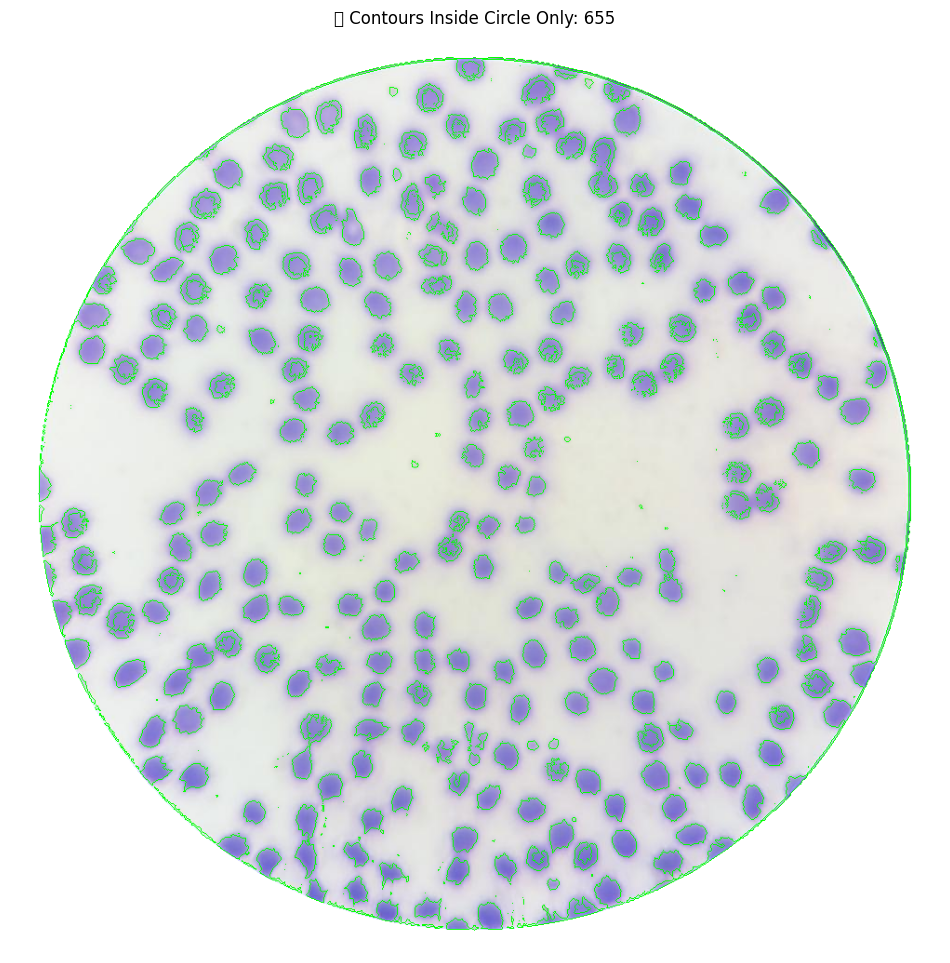

In [37]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Negatives\N_3.jpg"
original = cv2.imread(img_path)

# Convert to grayscale
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)

# Detect the circular region using HoughCircles
circles = cv2.HoughCircles(
    gray,
    cv2.HOUGH_GRADIENT,
    dp=1.2,
    minDist=1000,
    param1=100,
    param2=30,
    minRadius=100,
    maxRadius=0
)

# If a circle is found
if circles is not None:
    circles = np.uint16(np.around(circles))
    mask = np.zeros_like(gray)

    # ✅ Use only the first detected circle
    x, y, r = circles[0][0]
    cv2.circle(mask, (x, y), r, 255, thickness=-1)

    # Apply mask to keep only the circular area
    masked_img = cv2.bitwise_and(original, original, mask=mask)
    
    # Set everything outside the circle to white
    white_bg = np.full_like(original, 255)
    final_img = np.where(mask[:, :, None] == 255, masked_img, white_bg)

    # Convert to grayscale for processing
    gray_final = cv2.cvtColor(final_img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur
    blurred = cv2.GaussianBlur(gray_final, (5, 5), 0)

    # Adaptive thresholding
    binary = cv2.adaptiveThreshold(
        blurred, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11, 2
    )

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Draw contours
    contour_img = final_img.copy()
    cv2.drawContours(contour_img, contours, -1, (0, 255, 0), 1)

    # Display
    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB))
    plt.title(f"🧬 Contours Inside Circle Only: {len(contours)}")
    plt.axis("off")
    plt.show()

else:
    print("❌ No circle detected. Try tuning the HoughCircles parameters.")


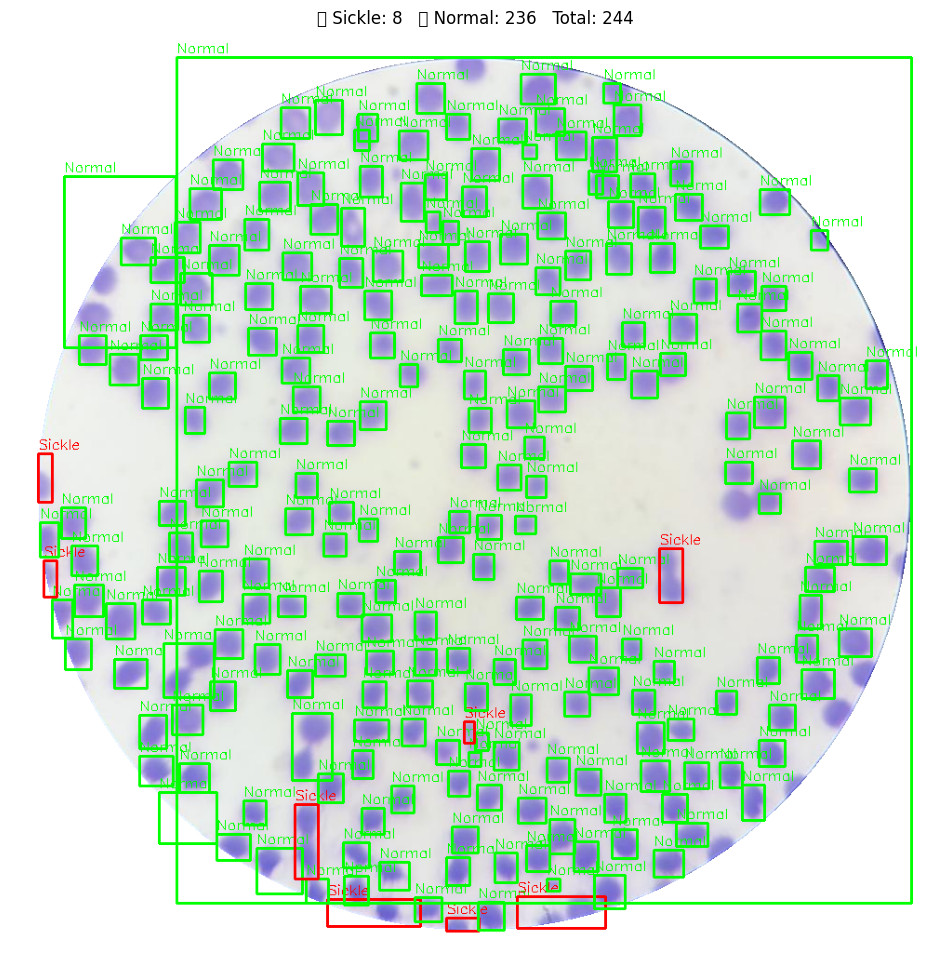

In [39]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Negatives\N_3.jpg"
original = cv2.imread(img_path)

# Convert to grayscale
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)

# Detect the circular region using HoughCircles
circles = cv2.HoughCircles(
    gray,
    cv2.HOUGH_GRADIENT,
    dp=1.2,
    minDist=1000,
    param1=100,
    param2=30,
    minRadius=100,
    maxRadius=0
)

if circles is not None:
    circles = np.uint16(np.around(circles))
    x, y, r = circles[0][0]

    # Create a circular mask
    mask = np.zeros_like(gray)
    cv2.circle(mask, (x, y), r, 255, thickness=-1)

    # Mask image and set background to white
    masked_img = cv2.bitwise_and(original, original, mask=mask)
    white_bg = np.full_like(original, 255)
    final_img = np.where(mask[:, :, None] == 255, masked_img, white_bg)

    # Grayscale and blur
    gray_final = cv2.cvtColor(final_img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray_final, (5, 5), 0)

    # Threshold
    binary = cv2.adaptiveThreshold(
        blurred, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11, 2
    )

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = final_img.copy()

    sickle_count = 0
    normal_count = 0

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < 100:  # Skip small blobs
            continue

        perimeter = cv2.arcLength(cnt, True)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / float(h)
        hull = cv2.convexHull(cnt)
        hull_area = cv2.contourArea(hull)
        solidity = area / hull_area if hull_area > 0 else 0
        circularity = 4 * np.pi * area / (perimeter * perimeter + 1e-6)

        # Identify sickle cell based on shape heuristics
        if circularity < 0.5 and solidity < 0.85 and (aspect_ratio > 1.7 or aspect_ratio < 0.5):
            shape = "Sickle"
            color = (0, 0, 255)  # Red
            sickle_count += 1
        else:
            shape = "Normal"
            color = (0, 255, 0)  # Green
            normal_count += 1

        # Draw rectangle and label
        cv2.rectangle(output, (x, y), (x + w, y + h), color, 2)
        cv2.putText(output, shape, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    # Show final image
    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(f"🟥 Sickle: {sickle_count}   🟩 Normal: {normal_count}   Total: {sickle_count + normal_count}")
    plt.axis("off")
    plt.show()

else:
    print("❌ No circle detected. Adjust HoughCircles parameters.")



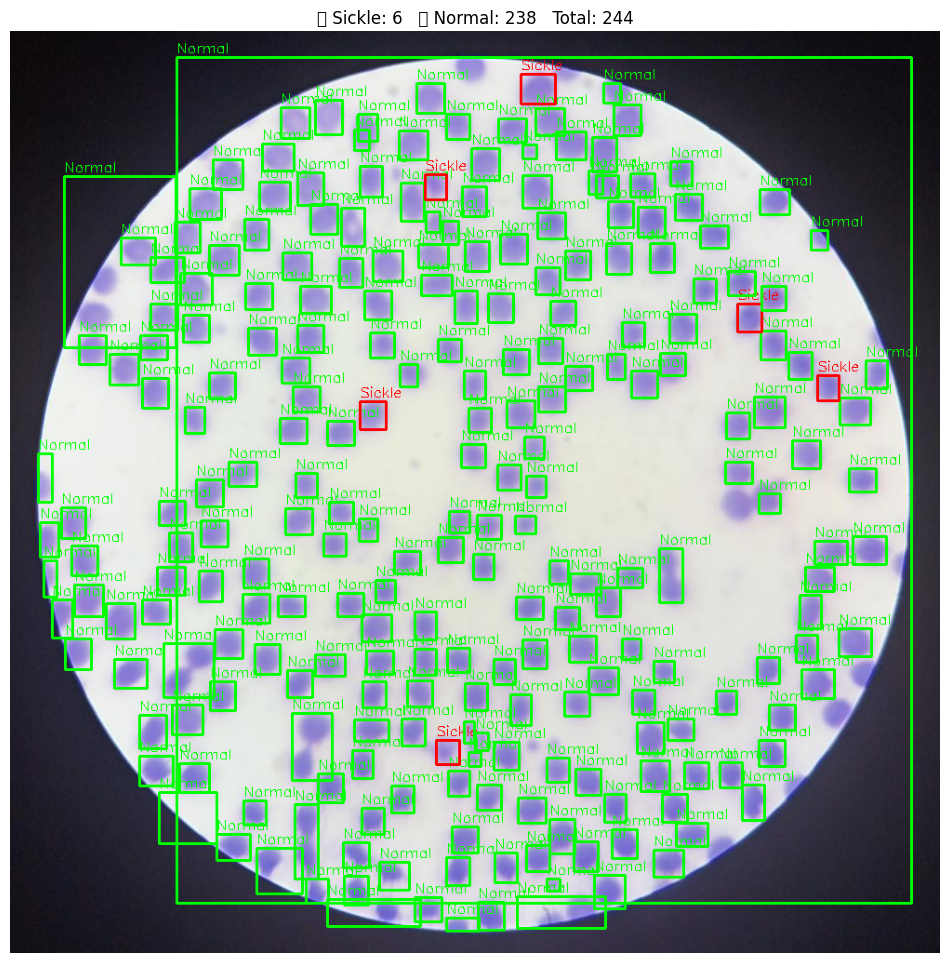

In [42]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# Load your trained DenseNet model
model = tf.keras.models.load_model('model_fold5.h5')

# Load the microscope image
img_path = r"D:\dataset_initial\Negatives\N_3.jpg"
original = cv2.imread(img_path)

# Convert to grayscale
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)

# Detect the circular microscope area
circles = cv2.HoughCircles(
    gray,
    cv2.HOUGH_GRADIENT,
    dp=1.2,
    minDist=1000,
    param1=100,
    param2=30,
    minRadius=100,
    maxRadius=0
)

if circles is not None:
    circles = np.uint16(np.around(circles))
    x_c, y_c, r_c = circles[0][0]

    # Create circular mask
    mask = np.zeros_like(gray)
    cv2.circle(mask, (x_c, y_c), r_c, 255, thickness=-1)

    # Apply mask to keep only circular area
    masked_img = cv2.bitwise_and(original, original, mask=mask)
    white_bg = np.full_like(original, 255)
    final_img = np.where(mask[:, :, None] == 255, masked_img, white_bg)

    # Convert to grayscale for contour detection
    gray_final = cv2.cvtColor(final_img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray_final, (5, 5), 0)
    binary = cv2.adaptiveThreshold(
        blurred, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11, 2
    )

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = original.copy()
    sickle_count = 0
    normal_count = 0

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < 100:
            continue  # Skip tiny noise

        # Get bounding box and crop safely
        x, y, w, h = cv2.boundingRect(cnt)
        pad = 10
        h_img, w_img = original.shape[:2]
        x1 = max(x - pad, 0)
        y1 = max(y - pad, 0)
        x2 = min(x + w + pad, w_img)
        y2 = min(y + h + pad, h_img)

        # Make square crop
        box_w = x2 - x1
        box_h = y2 - y1
        max_side = max(box_w, box_h)
        x2 = x1 + max_side
        y2 = y1 + max_side
        if x2 > w_img:
            x1 = w_img - max_side
            x2 = w_img
        if y2 > h_img:
            y1 = h_img - max_side
            y2 = h_img

        cell_crop = original[y1:y2, x1:x2]

        # Resize to model input
        resized = cv2.resize(cell_crop, (224, 224))
        normalized = resized / 255.0
        input_img = np.expand_dims(normalized, axis=0)

        # Predict probability
        prob = model.predict(input_img, verbose=0)[0][0]

        # Shape-based filtering (circularity)
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            continue
        circularity = 4 * np.pi * (area / (perimeter * perimeter))

        # Apply hybrid logic: model + shape
        if prob > 0.9 and circularity < 0.75:
            label = "Sickle"
            color = (0, 0, 255)  # Red
            sickle_count += 1
        else:
            label = "Normal"
            color = (0, 255, 0)  # Green
            normal_count += 1

        # Draw result
        cv2.rectangle(output, (x, y), (x + w, y + h), color, 2)
        cv2.putText(output, label, (x, y - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    # Show final annotated image
    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(f"🟥 Sickle: {sickle_count}   🟩 Normal: {normal_count}   Total: {sickle_count + normal_count}")
    plt.axis("off")
    plt.show()

else:
    print("❌ No microscope circle detected.")


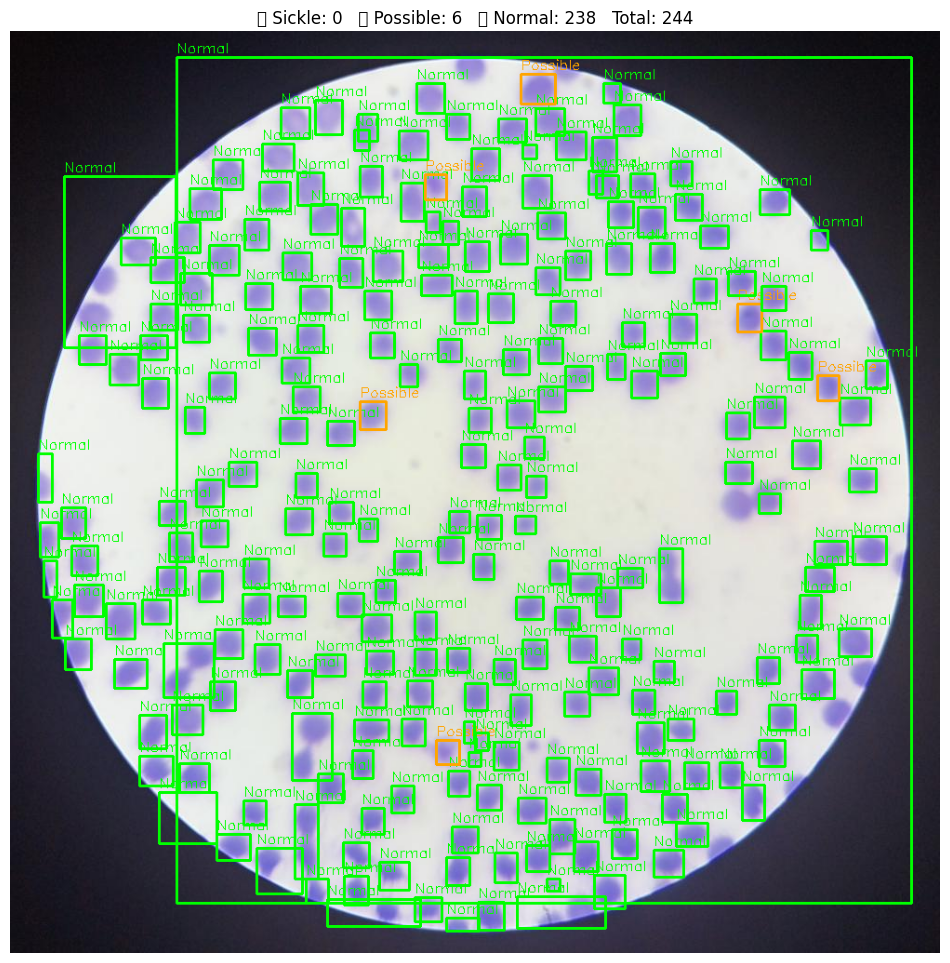

In [43]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# Load trained model
model = tf.keras.models.load_model('model_fold5.h5')

# Load and preprocess image
img_path = r"D:\dataset_initial\Negatives\N_3.jpg"
original = cv2.imread(img_path)
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)

# Detect microscope circle
circles = cv2.HoughCircles(
    gray, cv2.HOUGH_GRADIENT,
    dp=1.2, minDist=1000,
    param1=100, param2=30,
    minRadius=100, maxRadius=0
)

if circles is not None:
    circles = np.uint16(np.around(circles))
    x_c, y_c, r_c = circles[0][0]

    # Mask inside circle
    mask = np.zeros_like(gray)
    cv2.circle(mask, (x_c, y_c), r_c, 255, thickness=-1)
    masked_img = cv2.bitwise_and(original, original, mask=mask)
    white_bg = np.full_like(original, 255)
    final_img = np.where(mask[:, :, None] == 255, masked_img, white_bg)

    # Thresholding
    gray_final = cv2.cvtColor(final_img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray_final, (5, 5), 0)
    binary = cv2.adaptiveThreshold(
        blurred, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11, 2
    )

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Output image and counts
    output = original.copy()
    sickle_count = 0
    possible_sickle_count = 0
    normal_count = 0

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < 100:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        pad = 10
        h_img, w_img = original.shape[:2]
        x1 = max(x - pad, 0)
        y1 = max(y - pad, 0)
        x2 = min(x + w + pad, w_img)
        y2 = min(y + h + pad, h_img)

        box_w = x2 - x1
        box_h = y2 - y1
        max_side = max(box_w, box_h)
        x2 = x1 + max_side
        y2 = y1 + max_side
        if x2 > w_img: x1 = w_img - max_side; x2 = w_img
        if y2 > h_img: y1 = h_img - max_side; y2 = h_img

        cell_crop = original[y1:y2, x1:x2]
        resized = cv2.resize(cell_crop, (224, 224))
        normalized = resized / 255.0
        input_img = np.expand_dims(normalized, axis=0)

        # Predict probability
        prob = model.predict(input_img, verbose=0)[0][0]

        # Circularity filter
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            continue
        circularity = 4 * np.pi * (area / (perimeter * perimeter))

        # Classification
        if prob > 0.97 and circularity < 0.75:
            label = "Sickle"
            color = (0, 0, 255)  # Red
            sickle_count += 1
        elif 0.90 < prob <= 0.97 and circularity < 0.75:
            label = "Possible"
            color = (0, 165, 255)  # Orange
            possible_sickle_count += 1
        else:
            label = "Normal"
            color = (0, 255, 0)  # Green
            normal_count += 1

        # Draw box and label
        cv2.rectangle(output, (x, y), (x + w, y + h), color, 2)
        cv2.putText(output, label, (x, y - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    # Final display
    total = sickle_count + possible_sickle_count + normal_count
    title = f"🟥 Sickle: {sickle_count}   🟧 Possible: {possible_sickle_count}   🟩 Normal: {normal_count}   Total: {total}"

    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")
    plt.show()

else:
    print("❌ No microscope circle detected.")


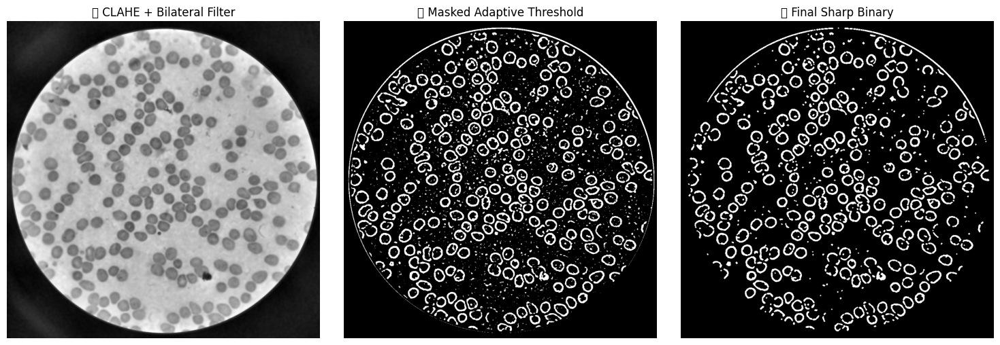

In [51]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Negatives\N_1.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 1: Enhance contrast using CLAHE
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)

# Step 2: Bilateral filter to preserve edges but reduce noise
filtered = cv2.bilateralFilter(enhanced, d=9, sigmaColor=75, sigmaSpace=75)

# Step 3: Detect circular microscope area
circles = cv2.HoughCircles(
    gray, cv2.HOUGH_GRADIENT,
    dp=1.2, minDist=1000,
    param1=100, param2=30,
    minRadius=100, maxRadius=0
)

if circles is not None:
    circles = np.uint16(np.around(circles))
    x, y, r = circles[0][0]

    # Mask for circle area
    mask = np.zeros_like(gray)
    cv2.circle(mask, (x, y), r, 255, -1)

    # Step 4: Adaptive threshold on filtered image
    adaptive = cv2.adaptiveThreshold(
        filtered, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11, 2
    )

    # Apply circular mask
    masked_binary = cv2.bitwise_and(adaptive, mask)

    # Step 5: Morph operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    clean = cv2.morphologyEx(masked_binary, cv2.MORPH_OPEN, kernel, iterations=2)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel, iterations=2)

    # Final display
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(filtered, cmap='gray')
    plt.title("✨ CLAHE + Bilateral Filter")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(masked_binary, cmap='gray')
    plt.title("🔍 Masked Adaptive Threshold")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(clean, cmap='gray')
    plt.title("🧼 Final Sharp Binary")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

else:
    print("❌ Circle not detected.")



C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\2850210396.py:119: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\2850210396.py:119: UserWarning: Glyph 129529 (\N{BROOM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\2850210396.py:119: UserWarning: Glyph 128207 (\N{STRAIGHT RULER}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\2850210396.py:119: UserWarning: Glyph 11093 (\N{HEAVY LARGE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\2850210396.py:119: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\17bin\anaconda3\envs\tf_env\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 129529 (\N{BROOM}) missing from font(s) DejaVu Sans

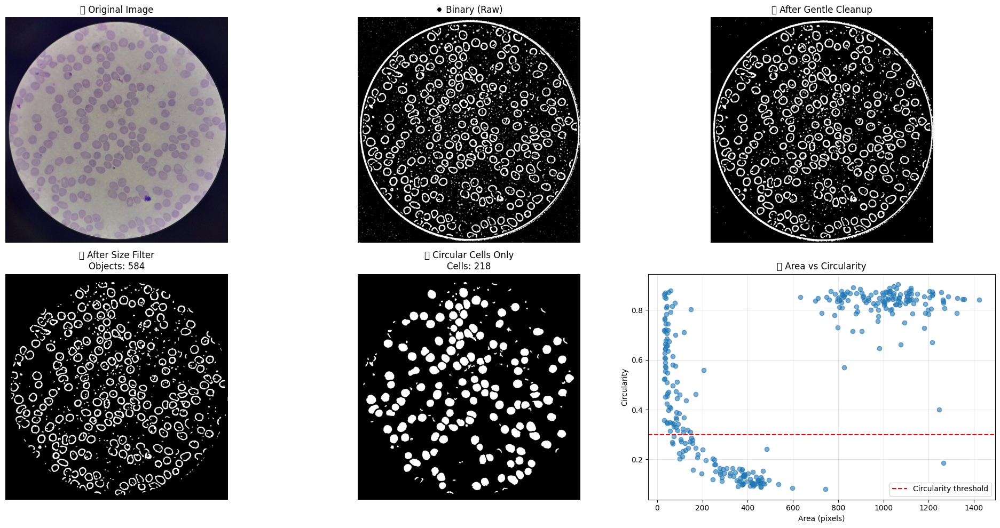

Total objects after size filter: 584
Circular cells detected: 218
Min area threshold: 15
Circularity threshold: 0.3


In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 🧾 Load and process original image
img_path = r"D:\dataset_initial\Negatives\N_1.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# CLAHE enhancement
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_img = clahe.apply(gray)

# Bilateral filter
bilateral = cv2.bilateralFilter(clahe_img, d=9, sigmaColor=75, sigmaSpace=75)

# Adaptive thresholding
binary = cv2.adaptiveThreshold(
    bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, blockSize=11, C=2
)

# GENTLE morphological operations - preserve cell shapes
# Use small kernel for minimal noise removal
small_kernel = np.ones((2, 2), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, small_kernel, iterations=1)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, small_kernel, iterations=1)

# Remove small connected components ONLY (keep the round cells)
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)

# Much smaller minimum area - only remove tiny noise dots
min_area = 15   # Very small - only removes tiny dots
max_area = 5000  # Large enough to keep all cells

final_clean = np.zeros_like(cleaned)
cell_count = 0

for i in range(1, num_labels):  # Skip background (label 0)
    area = stats[i, cv2.CC_STAT_AREA]
    if min_area <= area <= max_area:
        final_clean[labels == i] = 255
        cell_count += 1

# Alternative approach: Use contour detection to identify circular shapes
contours, _ = cv2.findContours(final_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours based on circularity and size
circular_cells = np.zeros_like(final_clean)
circular_count = 0

for contour in contours:
    area = cv2.contourArea(contour)
    if area > 30:  # Minimum area for actual cells
        # Check circularity
        perimeter = cv2.arcLength(contour, True)
        if perimeter > 0:
            circularity = 4 * np.pi * area / (perimeter * perimeter)
            
            # Keep objects that are reasonably circular (cells are round)
            if circularity > 0.3:  # Adjust this threshold (0.3-0.8 range)
                cv2.drawContours(circular_cells, [contour], -1, 255, -1)
                circular_count += 1

# 📊 Display results
plt.figure(figsize=(20, 10))

# Original image
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("🖼️ Original Image")
plt.axis("off")

# Binary after adaptive threshold
plt.subplot(2, 3, 2)
plt.imshow(binary, cmap='gray')
plt.title("⚫ Binary (Raw)")
plt.axis("off")

# After gentle morphological operations
plt.subplot(2, 3, 3)
plt.imshow(cleaned, cmap='gray')
plt.title("🧹 After Gentle Cleanup")
plt.axis("off")

# After size filtering
plt.subplot(2, 3, 4)
plt.imshow(final_clean, cmap='gray')
plt.title(f"📏 After Size Filter\nObjects: {cell_count}")
plt.axis("off")

# Final result - circular objects only
plt.subplot(2, 3, 5)
plt.imshow(circular_cells, cmap='gray')
plt.title(f"⭕ Circular Cells Only\nCells: {circular_count}")
plt.axis("off")

# Show area distribution
plt.subplot(2, 3, 6)
areas = []
circularities = []
for contour in contours:
    area = cv2.contourArea(contour)
    if area > 30:
        areas.append(area)
        perimeter = cv2.arcLength(contour, True)
        if perimeter > 0:
            circularity = 4 * np.pi * area / (perimeter * perimeter)
            circularities.append(circularity)

plt.scatter(areas, circularities, alpha=0.6)
plt.axhline(y=0.3, color='r', linestyle='--', label='Circularity threshold')
plt.xlabel("Area (pixels)")
plt.ylabel("Circularity")
plt.title("📊 Area vs Circularity")
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print(f"Total objects after size filter: {cell_count}")
print(f"Circular cells detected: {circular_count}")
print(f"Min area threshold: {min_area}")
print(f"Circularity threshold: 0.3")

# Optional: Save the cleaned image
# cv2.imwrite('cleaned_cells.jpg', circular_cells)

Found 218 valid cells for classification


Model loaded successfully!


C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 11093 (\N{HEAVY LARGE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 127912 (\N{ARTIST PALETTE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\662484074.py:189: UserWarning: Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu S

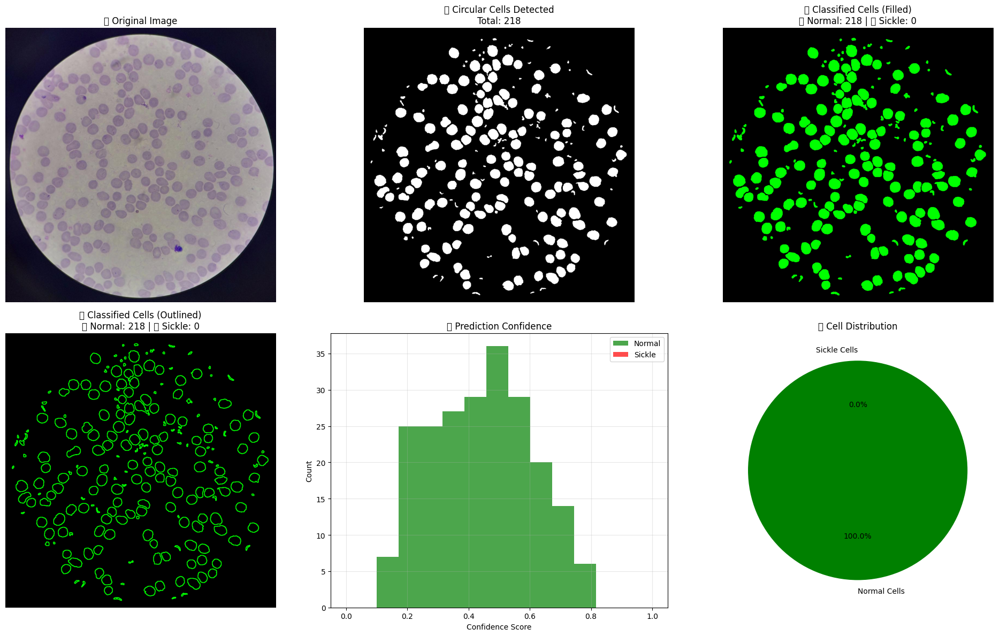


🔬 SICKLE CELL ANALYSIS RESULTS
Total cells detected: 218
Normal cells: 218 (100.0%)
Sickle cells: 0 (0.0%)
Average confidence: 0.445

💾 Results saved as 'highlighted_cells.jpg' and 'outlined_cells.jpg'

📋 Detailed Results:
Cell 1: Normal (Confidence: 0.181)
Cell 2: Normal (Confidence: 0.250)
Cell 3: Normal (Confidence: 0.243)
Cell 4: Normal (Confidence: 0.400)
Cell 5: Normal (Confidence: 0.599)
Cell 6: Normal (Confidence: 0.306)
Cell 7: Normal (Confidence: 0.100)
Cell 8: Normal (Confidence: 0.498)
Cell 9: Normal (Confidence: 0.195)
Cell 10: Normal (Confidence: 0.212)
Cell 11: Normal (Confidence: 0.506)
Cell 12: Normal (Confidence: 0.455)
Cell 13: Normal (Confidence: 0.491)
Cell 14: Normal (Confidence: 0.357)
Cell 15: Normal (Confidence: 0.586)
Cell 16: Normal (Confidence: 0.380)
Cell 17: Normal (Confidence: 0.290)
Cell 18: Normal (Confidence: 0.361)
Cell 19: Normal (Confidence: 0.530)
Cell 20: Normal (Confidence: 0.488)
Cell 21: Normal (Confidence: 0.316)
Cell 22: Normal (Confidence: 

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os

# 🧾 Load and process original image
img_path = r"D:\dataset_initial\Negatives\N_1.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# CLAHE enhancement
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_img = clahe.apply(gray)

# Bilateral filter
bilateral = cv2.bilateralFilter(clahe_img, d=9, sigmaColor=75, sigmaSpace=75)

# Adaptive thresholding
binary = cv2.adaptiveThreshold(
    bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, blockSize=11, C=2
)

# GENTLE morphological operations - preserve cell shapes
small_kernel = np.ones((2, 2), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, small_kernel, iterations=1)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, small_kernel, iterations=1)

# Remove small connected components ONLY
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)

min_area = 15   # Very small - only removes tiny dots
max_area = 5000  # Large enough to keep all cells

final_clean = np.zeros_like(cleaned)
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if min_area <= area <= max_area:
        final_clean[labels == i] = 255

# Get contours for circular cells
contours, _ = cv2.findContours(final_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours based on circularity and size
valid_contours = []
for contour in contours:
    area = cv2.contourArea(contour)
    if area > 30:  # Minimum area for actual cells
        perimeter = cv2.arcLength(contour, True)
        if perimeter > 0:
            circularity = 4 * np.pi * area / (perimeter * perimeter)
            if circularity > 0.3:  # Reasonably circular
                valid_contours.append(contour)

print(f"Found {len(valid_contours)} valid cells for classification")

# 🤖 Load your trained model
model_path = "model_fold5.h5"
if os.path.exists(model_path):
    model = load_model(model_path)
    print("Model loaded successfully!")
else:
    print(f"Model not found at {model_path}")
    print("Please check the path and make sure the model file exists")
    exit()

# 🔍 Extract and classify each cell
normal_cells = []
sickle_cells = []
cell_predictions = []

# Assume your model expects images of size (64, 64) or (224, 224)
# Adjust this based on your model's input size
IMG_SIZE = 224  # Change this to match your model's input size

for i, contour in enumerate(valid_contours):
    # Get bounding box for each cell
    x, y, w, h = cv2.boundingRect(contour)
    
    # Add padding to get better cell extraction
    padding = 10
    x1 = max(0, x - padding)
    y1 = max(0, y - padding)
    x2 = min(img.shape[1], x + w + padding)
    y2 = min(img.shape[0], y + h + padding)
    
    # Extract cell from original image
    cell_img = img[y1:y2, x1:x2]
    
    if cell_img.size > 0:
        # Resize to model input size
        cell_resized = cv2.resize(cell_img, (IMG_SIZE, IMG_SIZE))
        
        # Preprocess for model (adjust based on your training preprocessing)
        cell_array = img_to_array(cell_resized)
        cell_array = np.expand_dims(cell_array, axis=0)
        cell_array = cell_array / 255.0  # Normalize if you did this during training
        
        # Make prediction
        prediction = model.predict(cell_array, verbose=0)
        pred_class = np.argmax(prediction)
        confidence = np.max(prediction)
        
        # Store results
        cell_predictions.append((contour, pred_class, confidence))
        
        # Classify as normal (0) or sickle (1) - adjust based on your model
        if pred_class == 0:  # Normal cell
            normal_cells.append(contour)
        else:  # Sickle cell
            sickle_cells.append(contour)

# 🎨 Create highlighted image
highlighted_img = np.zeros_like(img)

# Draw normal cells in GREEN
for contour in normal_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), 2)  # Green border
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), -1)  # Green fill (light)

# Draw sickle cells in RED
for contour in sickle_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), 2)  # Red border
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), -1)  # Red fill (light)

# Create a version with just the outlines for better visibility
outline_img = np.zeros_like(img)
for contour in normal_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 255, 0), 2)  # Green outline
for contour in sickle_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 0, 255), 2)  # Red outline

# 📊 Display results
plt.figure(figsize=(20, 12))

# Original image
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("🖼️ Original Image")
plt.axis("off")

# Circular cells detected
circular_cells = np.zeros_like(final_clean)
for contour in valid_contours:
    cv2.drawContours(circular_cells, [contour], -1, 255, -1)

plt.subplot(2, 3, 2)
plt.imshow(circular_cells, cmap='gray')
plt.title(f"⭕ Circular Cells Detected\nTotal: {len(valid_contours)}")
plt.axis("off")

# Highlighted cells (filled)
plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(highlighted_img, cv2.COLOR_BGR2RGB))
plt.title(f"🎨 Classified Cells (Filled)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Outlined cells (cleaner view)
plt.subplot(2, 3, 4)
plt.imshow(cv2.cvtColor(outline_img, cv2.COLOR_BGR2RGB))
plt.title(f"📍 Classified Cells (Outlined)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Confidence distribution
plt.subplot(2, 3, 5)
confidences = [pred[2] for pred in cell_predictions]
classes = [pred[1] for pred in cell_predictions]
normal_conf = [conf for conf, cls in zip(confidences, classes) if cls == 0]
sickle_conf = [conf for conf, cls in zip(confidences, classes) if cls == 1]

plt.hist(normal_conf, bins=10, alpha=0.7, label='Normal', color='green')
plt.hist(sickle_conf, bins=10, alpha=0.7, label='Sickle', color='red')
plt.xlabel("Confidence Score")
plt.ylabel("Count")
plt.title("📊 Prediction Confidence")
plt.legend()
plt.grid(True, alpha=0.3)

# Summary statistics
plt.subplot(2, 3, 6)
labels = ['Normal Cells', 'Sickle Cells']
sizes = [len(normal_cells), len(sickle_cells)]
colors = ['green', 'red']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title("📈 Cell Distribution")

plt.tight_layout()
plt.show()

# 📋 Print detailed results
print("\n" + "="*50)
print("🔬 SICKLE CELL ANALYSIS RESULTS")
print("="*50)
print(f"Total cells detected: {len(valid_contours)}")
print(f"Normal cells: {len(normal_cells)} ({len(normal_cells)/len(valid_contours)*100:.1f}%)")
print(f"Sickle cells: {len(sickle_cells)} ({len(sickle_cells)/len(valid_contours)*100:.1f}%)")
print(f"Average confidence: {np.mean(confidences):.3f}")

# Save results
cv2.imwrite('highlighted_cells.jpg', highlighted_img)
cv2.imwrite('outlined_cells.jpg', outline_img)
print("\n💾 Results saved as 'highlighted_cells.jpg' and 'outlined_cells.jpg'")

# Detailed cell-by-cell results
print("\n📋 Detailed Results:")
for i, (contour, pred_class, confidence) in enumerate(cell_predictions):
    cell_type = "Normal" if pred_class == 0 else "Sickle"
    print(f"Cell {i+1}: {cell_type} (Confidence: {confidence:.3f})")

Found 250 valid cells for classification


Model loaded successfully!


C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 11093 (\N{HEAVY LARGE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 127912 (\N{ARTIST PALETTE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_1448\3491754286.py:189: UserWarning: Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) De

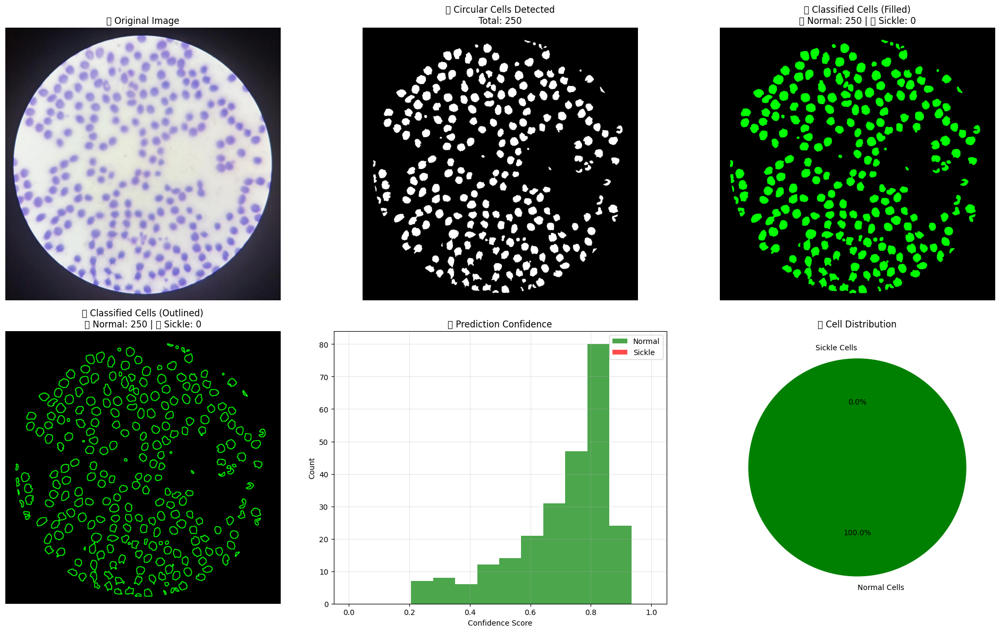


🔬 SICKLE CELL ANALYSIS RESULTS
Total cells detected: 250
Normal cells: 250 (100.0%)
Sickle cells: 0 (0.0%)
Average confidence: 0.706

💾 Results saved as 'highlighted_cells.jpg' and 'outlined_cells.jpg'

📋 Detailed Results:
Cell 1: Normal (Confidence: 0.666)
Cell 2: Normal (Confidence: 0.437)
Cell 3: Normal (Confidence: 0.306)
Cell 4: Normal (Confidence: 0.473)
Cell 5: Normal (Confidence: 0.706)
Cell 6: Normal (Confidence: 0.431)
Cell 7: Normal (Confidence: 0.386)
Cell 8: Normal (Confidence: 0.417)
Cell 9: Normal (Confidence: 0.671)
Cell 10: Normal (Confidence: 0.238)
Cell 11: Normal (Confidence: 0.739)
Cell 12: Normal (Confidence: 0.569)
Cell 13: Normal (Confidence: 0.331)
Cell 14: Normal (Confidence: 0.428)
Cell 15: Normal (Confidence: 0.508)
Cell 16: Normal (Confidence: 0.704)
Cell 17: Normal (Confidence: 0.812)
Cell 18: Normal (Confidence: 0.743)
Cell 19: Normal (Confidence: 0.616)
Cell 20: Normal (Confidence: 0.547)
Cell 21: Normal (Confidence: 0.601)
Cell 22: Normal (Confidence: 

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os

# 🧾 Load and process original image
img_path = r"D:\dataset_initial\Negatives\N_3.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# CLAHE enhancement
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_img = clahe.apply(gray)

# Bilateral filter
bilateral = cv2.bilateralFilter(clahe_img, d=9, sigmaColor=75, sigmaSpace=75)

# Adaptive thresholding
binary = cv2.adaptiveThreshold(
    bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, blockSize=11, C=2
)

# GENTLE morphological operations - preserve cell shapes
small_kernel = np.ones((2, 2), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, small_kernel, iterations=1)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, small_kernel, iterations=1)

# Remove small connected components ONLY
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)

min_area = 15   # Very small - only removes tiny dots
max_area = 5000  # Large enough to keep all cells

final_clean = np.zeros_like(cleaned)
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if min_area <= area <= max_area:
        final_clean[labels == i] = 255

# Get contours for circular cells
contours, _ = cv2.findContours(final_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours based on circularity and size
valid_contours = []
for contour in contours:
    area = cv2.contourArea(contour)
    if area > 30:  # Minimum area for actual cells
        perimeter = cv2.arcLength(contour, True)
        if perimeter > 0:
            circularity = 4 * np.pi * area / (perimeter * perimeter)
            if circularity > 0.3:  # Reasonably circular
                valid_contours.append(contour)

print(f"Found {len(valid_contours)} valid cells for classification")

# 🤖 Load your trained model
model_path = "model_fold5.h5"
if os.path.exists(model_path):
    model = load_model(model_path)
    print("Model loaded successfully!")
else:
    print(f"Model not found at {model_path}")
    print("Please check the path and make sure the model file exists")
    exit()

# 🔍 Extract and classify each cell
normal_cells = []
sickle_cells = []
cell_predictions = []

# Assume your model expects images of size (64, 64) or (224, 224)
# Adjust this based on your model's input size
IMG_SIZE = 224  # Change this to match your model's input size

for i, contour in enumerate(valid_contours):
    # Get bounding box for each cell
    x, y, w, h = cv2.boundingRect(contour)
    
    # Add padding to get better cell extraction
    padding = 10
    x1 = max(0, x - padding)
    y1 = max(0, y - padding)
    x2 = min(img.shape[1], x + w + padding)
    y2 = min(img.shape[0], y + h + padding)
    
    # Extract cell from original image
    cell_img = img[y1:y2, x1:x2]
    
    if cell_img.size > 0:
        # Resize to model input size
        cell_resized = cv2.resize(cell_img, (IMG_SIZE, IMG_SIZE))
        
        # Preprocess for model (adjust based on your training preprocessing)
        cell_array = img_to_array(cell_resized)
        cell_array = np.expand_dims(cell_array, axis=0)
        cell_array = cell_array / 255.0  # Normalize if you did this during training
        
        # Make prediction
        prediction = model.predict(cell_array, verbose=0)
        pred_class = np.argmax(prediction)
        confidence = np.max(prediction)
        
        # Store results
        cell_predictions.append((contour, pred_class, confidence))
        
        # Classify as normal (0) or sickle (1) - adjust based on your model
        if pred_class == 0:  # Normal cell
            normal_cells.append(contour)
        else:  # Sickle cell
            sickle_cells.append(contour)

# 🎨 Create highlighted image
highlighted_img = np.zeros_like(img)

# Draw normal cells in GREEN
for contour in normal_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), 2)  # Green border
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), -1)  # Green fill (light)

# Draw sickle cells in RED
for contour in sickle_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), 2)  # Red border
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), -1)  # Red fill (light)

# Create a version with just the outlines for better visibility
outline_img = np.zeros_like(img)
for contour in normal_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 255, 0), 2)  # Green outline
for contour in sickle_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 0, 255), 2)  # Red outline

# 📊 Display results
plt.figure(figsize=(20, 12))

# Original image
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("🖼️ Original Image")
plt.axis("off")

# Circular cells detected
circular_cells = np.zeros_like(final_clean)
for contour in valid_contours:
    cv2.drawContours(circular_cells, [contour], -1, 255, -1)

plt.subplot(2, 3, 2)
plt.imshow(circular_cells, cmap='gray')
plt.title(f"⭕ Circular Cells Detected\nTotal: {len(valid_contours)}")
plt.axis("off")

# Highlighted cells (filled)
plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(highlighted_img, cv2.COLOR_BGR2RGB))
plt.title(f"🎨 Classified Cells (Filled)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Outlined cells (cleaner view)
plt.subplot(2, 3, 4)
plt.imshow(cv2.cvtColor(outline_img, cv2.COLOR_BGR2RGB))
plt.title(f"📍 Classified Cells (Outlined)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Confidence distribution
plt.subplot(2, 3, 5)
confidences = [pred[2] for pred in cell_predictions]
classes = [pred[1] for pred in cell_predictions]
normal_conf = [conf for conf, cls in zip(confidences, classes) if cls == 0]
sickle_conf = [conf for conf, cls in zip(confidences, classes) if cls == 1]

plt.hist(normal_conf, bins=10, alpha=0.7, label='Normal', color='green')
plt.hist(sickle_conf, bins=10, alpha=0.7, label='Sickle', color='red')
plt.xlabel("Confidence Score")
plt.ylabel("Count")
plt.title("📊 Prediction Confidence")
plt.legend()
plt.grid(True, alpha=0.3)

# Summary statistics
plt.subplot(2, 3, 6)
labels = ['Normal Cells', 'Sickle Cells']
sizes = [len(normal_cells), len(sickle_cells)]
colors = ['green', 'red']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title("📈 Cell Distribution")

plt.tight_layout()
plt.show()

# 📋 Print detailed results
print("\n" + "="*50)
print("🔬 SICKLE CELL ANALYSIS RESULTS")
print("="*50)
print(f"Total cells detected: {len(valid_contours)}")
print(f"Normal cells: {len(normal_cells)} ({len(normal_cells)/len(valid_contours)*100:.1f}%)")
print(f"Sickle cells: {len(sickle_cells)} ({len(sickle_cells)/len(valid_contours)*100:.1f}%)")
print(f"Average confidence: {np.mean(confidences):.3f}")

# Save results
cv2.imwrite('highlighted_cells.jpg', highlighted_img)
cv2.imwrite('outlined_cells.jpg', outline_img)
print("\n💾 Results saved as 'highlighted_cells.jpg' and 'outlined_cells.jpg'")

# Detailed cell-by-cell results
print("\n📋 Detailed Results:")
for i, (contour, pred_class, confidence) in enumerate(cell_predictions):
    cell_type = "Normal" if pred_class == 0 else "Sickle"
    print(f"Cell {i+1}: {cell_type} (Confidence: {confidence:.3f})")

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os

# 🧾 Load and process original image
img_path = r"D:\dataset_initial\Positives\3.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# CLAHE enhancement
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_img = clahe.apply(gray)

# Bilateral filter
bilateral = cv2.bilateralFilter(clahe_img, d=9, sigmaColor=75, sigmaSpace=75)

# Adaptive thresholding
binary = cv2.adaptiveThreshold(
    bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, blockSize=11, C=2
)

# GENTLE morphological operations - preserve cell shapes
small_kernel = np.ones((2, 2), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, small_kernel, iterations=1)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, small_kernel, iterations=1)

# Remove small connected components ONLY
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)

min_area = 50  # Increased to remove tiny dots
max_area = 5000

final_clean = np.zeros_like(cleaned)
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if min_area <= area <= max_area:
        final_clean[labels == i] = 255

# 🔴 Mask anything outside the microscope circle
mask = np.zeros_like(final_clean)
h, w = final_clean.shape
cv2.circle(mask, (w // 2, h // 2), min(w, h) // 2 - 5, 255, -1)
final_clean = cv2.bitwise_and(final_clean, final_clean, mask=mask)

# ⚙️ Smooth edges and clean noise
kernel = np.ones((3, 3), np.uint8)
final_clean = cv2.morphologyEx(final_clean, cv2.MORPH_OPEN, kernel, iterations=2)
final_clean = cv2.morphologyEx(final_clean, cv2.MORPH_CLOSE, kernel, iterations=2)
final_clean = cv2.GaussianBlur(final_clean, (3, 3), 0)

# Contour Detection
contours, _ = cv2.findContours(final_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours and determine shapes
valid_contours = []
cell_shapes = []

for contour in contours:
    area = cv2.contourArea(contour)
    if area > 30:
        perimeter = cv2.arcLength(contour, True)
        if perimeter > 0:
            circularity = 4 * np.pi * area / (perimeter * perimeter)
            x, y, w, h = cv2.boundingRect(contour)
            aspect_ratio = max(w, h) / min(w, h)
            hull = cv2.convexHull(contour)
            hull_area = cv2.contourArea(hull)
            solidity = area / hull_area if hull_area > 0 else 0

            is_circular = circularity > 0.3 and aspect_ratio < 2.0
            is_elongated = (circularity > 0.1 and aspect_ratio > 1.5 and solidity > 0.6) or \
                           (circularity > 0.15 and aspect_ratio > 1.2 and solidity > 0.7)

            if is_circular or is_elongated:
                valid_contours.append(contour)
                cell_shapes.append("circular" if is_circular else "elongated")

print(f"Found {len(valid_contours)} valid cells for classification")
print(f"Circular shapes: {cell_shapes.count('circular')}")
print(f"Elongated shapes: {cell_shapes.count('elongated')}")

# 🤖 Load your trained model
model_path = "model_fold5.h5"
if os.path.exists(model_path):
    model = load_model(model_path)
    print("Model loaded successfully!")
else:
    print(f"Model not found at {model_path}")
    exit()

# 🔍 Classify each detected cell
normal_cells = []
sickle_cells = []
cell_predictions = []

IMG_SIZE = 224

for i, contour in enumerate(valid_contours):
    x, y, w, h = cv2.boundingRect(contour)
    padding = 10
    x1 = max(0, x - padding)
    y1 = max(0, y - padding)
    x2 = min(img.shape[1], x + w + padding)
    y2 = min(img.shape[0], y + h + padding)

    cell_img = img[y1:y2, x1:x2]
    if cell_img.size > 0:
        cell_resized = cv2.resize(cell_img, (IMG_SIZE, IMG_SIZE))
        cell_array = img_to_array(cell_resized)
        cell_array = np.expand_dims(cell_array, axis=0)
        cell_array = cell_array / 255.0

        prediction = model.predict(cell_array, verbose=0)
        pred_class = np.argmax(prediction)
        confidence = np.max(prediction)

        cell_predictions.append((contour, pred_class, confidence, cell_shapes[i]))

        if pred_class == 0:
            normal_cells.append(contour)
        else:
            sickle_cells.append(contour)

# 🎨 Visualization
highlighted_img = np.zeros_like(img)
for contour in normal_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), 2)
    cv2.drawContours(highlighted_img, [contour], -1, (0, 100, 0), -1)
for contour in sickle_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), 2)
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 100), -1)

outline_img = np.zeros_like(img)
for contour in normal_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 255, 0), 2)
for contour in sickle_cells:
    cv2.drawContours(outline_img, [contour], -1, (0, 0, 255), 2)

shape_img = np.zeros_like(img)
for i, contour in enumerate(valid_contours):
    color = (255, 255, 0) if cell_shapes[i] == "circular" else (255, 0, 255)
    cv2.drawContours(shape_img, [contour], -1, color, 2)

plt.figure(figsize=(20, 15))

plt.subplot(3, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("🖼️ Original Image")
plt.axis("off")

plt.subplot(3, 3, 2)
plt.imshow(final_clean, cmap='gray')
plt.title("⚫ Processed Binary")
plt.axis("off")

plt.subplot(3, 3, 3)
plt.imshow(cv2.cvtColor(shape_img, cv2.COLOR_BGR2RGB))
plt.title(f"🔍 Shape Detection\n🟡 Circular: {cell_shapes.count('circular')} | 🟣 Elongated: {cell_shapes.count('elongated')}")
plt.axis("off")

all_cells_img = np.zeros_like(img)
for contour in valid_contours:
    cv2.drawContours(all_cells_img, [contour], -1, (255, 255, 255), -1)

plt.subplot(3, 3, 4)
plt.imshow(all_cells_img, cmap='gray')
plt.title(f"⭕ All Detected Cells\nTotal: {len(valid_contours)}")
plt.axis("off")

plt.subplot(3, 3, 5)
plt.imshow(cv2.cvtColor(highlighted_img, cv2.COLOR_BGR2RGB))
plt.title(f"🎨 Classified Cells (Filled)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

plt.subplot(3, 3, 6)
plt.imshow(cv2.cvtColor(outline_img, cv2.COLOR_BGR2RGB))
plt.title(f"📍 Classified Cells (Outlined)\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Confidence histogram
plt.subplot(3, 3, 7)
confidences = [pred[2] for pred in cell_predictions]
classes = [pred[1] for pred in cell_predictions]
normal_conf = [conf for conf, cls in zip(confidences, classes) if cls == 0]
sickle_conf = [conf for conf, cls in zip(confidences, classes) if cls == 1]
plt.hist(normal_conf, bins=10, alpha=0.7, label='Normal', color='green')
plt.hist(sickle_conf, bins=10, alpha=0.7, label='Sickle', color='red')
plt.xlabel("Confidence Score")
plt.ylabel("Count")
plt.title("📊 Prediction Confidence")
plt.legend()
plt.grid(True, alpha=0.3)

# Pie chart
plt.subplot(3, 3, 8)
labels = ['Normal Cells', 'Sickle Cells']
sizes = [len(normal_cells), len(sickle_cells)]
colors = ['green', 'red']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title("📈 Cell Distribution")

# Shape vs Classification
plt.subplot(3, 3, 9)
shape_types = [1 if pred[3] == "circular" else 2 for pred in cell_predictions]
predictions = [pred[1] for pred in cell_predictions]
plt.scatter(shape_types, predictions, alpha=0.7, s=50)
plt.xlabel("Shape Type")
plt.ylabel("Prediction")
plt.title("🔍 Shape vs Classification")
plt.xticks([1, 2], ['Circular', 'Elongated'])
plt.yticks([0, 1], ['Normal', 'Sickle'])
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# 📋 Final report
print("\n" + "=" * 50)
print("🔬 SICKLE CELL ANALYSIS RESULTS")
print("=" * 50)
print(f"Total cells detected: {len(valid_contours)}")
print(f"Normal cells: {len(normal_cells)} ({len(normal_cells)/len(valid_contours)*100:.1f}%)")
print(f"Sickle cells: {len(sickle_cells)} ({len(sickle_cells)/len(valid_contours)*100:.1f}%)")
print(f"Average confidence: {np.mean(confidences):.3f}")
print(f"Circular shapes detected: {cell_shapes.count('circular')}")
print(f"Elongated shapes detected: {cell_shapes.count('elongated')}")

# Save
cv2.imwrite('highlighted_cells.jpg', highlighted_img)
cv2.imwrite('outlined_cells.jpg', outline_img)
cv2.imwrite('shape_detection.jpg', shape_img)
print("\n💾 Results saved!")


KeyboardInterrupt: 

In [3]:
pip install scikit-image



   ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
    --------------------------------------- 0.3/12.8 MB ? eta -:--:--
    --------------------------------------- 0.3/12.8 MB ? eta -:--:--
    --------------------------------------- 0.3/12.8 MB ? eta -:--:--
   - -------------------------------------- 0.5/12.8 MB 452.8 kB/s eta 0:00:28
   -- ------------------------------------- 0.8/12.8 MB 588.4 kB/s eta 0:00:21
   --- ------------------------------------ 1.0/12.8 MB 708.5 kB/s eta 0:00:17
   --- ------------------------------------ 1.0/12.8 MB 708.5 kB/s eta 0:00:17
   --- ------------------------------------ 1.0/12.8 MB 708.5 kB/s eta 0:00:17
   ---- ----------------------------------- 

Found 41 valid cells for classification


Model loaded successfully!


C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 11093 (\N{HEAVY LARGE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3654250077.py:295: UserWarning: Glyph 127912 (\N{ARTIST PALETT

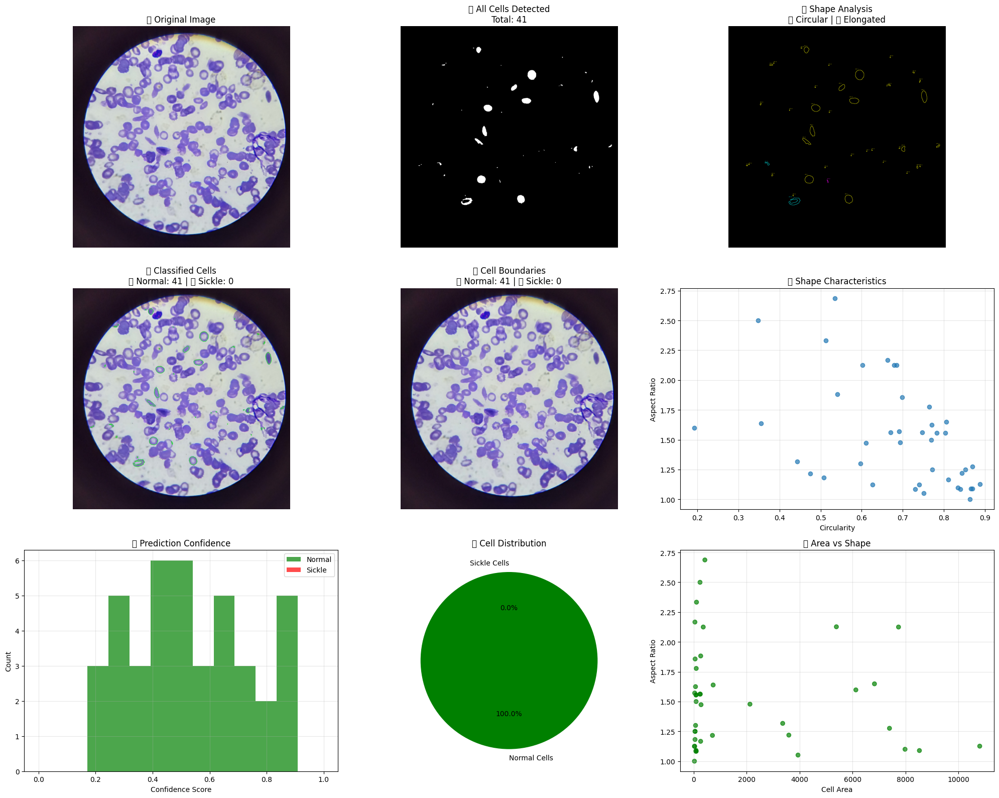


🔬 ENHANCED SICKLE CELL ANALYSIS RESULTS
Total cells detected: 41
Normal cells: 41 (100.0%)
Sickle cells: 0 (0.0%)
Average confidence: 0.532

Shape Analysis:
Circular shapes detected: 38
Elongated shapes detected: 7

💾 Results saved as 'enhanced_highlighted_cells.jpg', 'enhanced_outlined_cells.jpg', and 'shape_analysis.jpg'

📋 Detailed Results:
Cell 1: Normal | Shape: Elongated | Confidence: 0.845 | AR: 1.60 | Circularity: 0.193
Cell 2: Normal | Shape: Circular | Confidence: 0.278 | AR: 1.30 | Circularity: 0.597
Cell 3: Normal | Shape: Circular | Confidence: 0.620 | AR: 1.10 | Circularity: 0.834
Cell 4: Normal | Shape: Elongated | Confidence: 0.423 | AR: 2.50 | Circularity: 0.348
Cell 5: Normal | Shape: Circular | Confidence: 0.492 | AR: 1.09 | Circularity: 0.869
Cell 6: Normal | Shape: Circular | Confidence: 0.213 | AR: 1.17 | Circularity: 0.810
Cell 7: Normal | Shape: Circular | Confidence: 0.368 | AR: 1.25 | Circularity: 0.852
Cell 8: Normal | Shape: Circular | Confidence: 0.699 | A

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os

# 🧾 Load and process original image
img_path = r"D:\dataset_initial\Positives\3.jpg"
img = cv2.imread(img_path)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# CLAHE enhancement
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_img = clahe.apply(gray)

# Bilateral filter
bilateral = cv2.bilateralFilter(clahe_img, d=9, sigmaColor=75, sigmaSpace=75)

# Sharpen image to improve cell edge visibility
kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 5,-1],
                           [0, -1, 0]])
sharpened = cv2.filter2D(bilateral, -1, kernel_sharpen)

# Blur to reduce noise before thresholding
blurred = cv2.GaussianBlur(sharpened, (5, 5), 0)

# Combined Otsu + Morphology to catch faint boundaries
_, binary = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Morphological tweaks to connect weak boundaries
morph_kernel = np.ones((3, 3), np.uint8)
binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, morph_kernel, iterations=2)
binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, morph_kernel, iterations=1)



# GENTLE morphological operations - preserve cell shapes
small_kernel = np.ones((2, 2), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, small_kernel, iterations=1)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, small_kernel, iterations=1)

# Remove small connected components ONLY
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)

min_area = 15   # Very small - only removes tiny dots
max_area = 8000  # Increased to accommodate elongated sickle cells

final_clean = np.zeros_like(cleaned)
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if min_area <= area <= max_area:
        final_clean[labels == i] = 255

# Get contours for ALL cells (circular AND elongated)
contours, _ = cv2.findContours(final_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Enhanced contour filtering for BOTH circular and elongated cells
def analyze_contour_shape(contour):
    """Analyze contour to determine if it's a valid cell (circular or elongated)"""
    area = cv2.contourArea(contour)
    if area < 30:  # Too small
        return False, {}
    
    perimeter = cv2.arcLength(contour, True)
    if perimeter == 0:
        return False, {}
    
    # Calculate shape metrics
    circularity = 4 * np.pi * area / (perimeter * perimeter)
    
    # Get bounding rectangle
    x, y, w, h = cv2.boundingRect(contour)
    aspect_ratio = max(w, h) / min(w, h)
    
    # Get minimum enclosing rectangle for better orientation analysis
    rect = cv2.minAreaRect(contour)
    box = cv2.boxPoints(rect)
    box = np.int32(box)
    
    # Calculate extent (area ratio)
    rect_area = w * h
    extent = area / rect_area if rect_area > 0 else 0
    
    # Calculate solidity (convex hull ratio)
    hull = cv2.convexHull(contour)
    hull_area = cv2.contourArea(hull)
    solidity = area / hull_area if hull_area > 0 else 0
    
    shape_info = {
        'area': area,
        'perimeter': perimeter,
        'circularity': circularity,
        'aspect_ratio': aspect_ratio,
        'extent': extent,
        'solidity': solidity,
        'bounding_rect': (x, y, w, h)
    }
    
    # Classification criteria for BOTH cell types:
    # 1. Circular cells (normal): high circularity, low aspect ratio
    # 2. Elongated cells (sickle): low circularity, high aspect ratio, good solidity
    
    is_circular = (circularity > 0.4 and aspect_ratio < 2.0)
    is_elongated = (circularity > 0.1 and aspect_ratio > 1.5 and 
                   aspect_ratio < 6.0 and solidity > 0.6 and extent > 0.3)
    
    is_valid_cell = is_circular or is_elongated
    
    return is_valid_cell, shape_info

# Filter contours for both circular and elongated cells
valid_contours = []
shape_data = []

for contour in contours:
    is_valid, shape_info = analyze_contour_shape(contour)
    if is_valid:
        valid_contours.append(contour)
        shape_data.append(shape_info)

print(f"Found {len(valid_contours)} valid cells for classification")

# 🤖 Load your trained model
model_path = "model_fold5.h5"
if os.path.exists(model_path):
    model = load_model(model_path)
    print("Model loaded successfully!")
else:
    print(f"Model not found at {model_path}")
    print("Please check the path and make sure the model file exists")
    exit()

# 🔍 Extract and classify each cell
normal_cells = []
sickle_cells = []
cell_predictions = []

# Assume your model expects images of size (64, 64) or (224, 224)
IMG_SIZE = 224  # Change this to match your model's input size

for i, contour in enumerate(valid_contours):
    # Get bounding box for each cell
    x, y, w, h = cv2.boundingRect(contour)
    
    # Add padding to get better cell extraction
    padding = 15  # Increased padding for elongated cells
    x1 = max(0, x - padding)
    y1 = max(0, y - padding)
    x2 = min(img.shape[1], x + w + padding)
    y2 = min(img.shape[0], y + h + padding)
    
    # Extract cell from original image
    cell_img = img[y1:y2, x1:x2]
    
    if cell_img.size > 0:
        # Resize to model input size
        cell_resized = cv2.resize(cell_img, (IMG_SIZE, IMG_SIZE))
        
        # Preprocess for model (adjust based on your training preprocessing)
        cell_array = img_to_array(cell_resized)
        cell_array = np.expand_dims(cell_array, axis=0)
        cell_array = cell_array / 255.0  # Normalize if you did this during training
        
        # Make prediction
        prediction = model.predict(cell_array, verbose=0)
        pred_class = np.argmax(prediction)
        confidence = np.max(prediction)
        
        # Store results
        cell_predictions.append((contour, pred_class, confidence, shape_data[i]))
        
        # Classify as normal (0) or sickle (1) - adjust based on your model
        if pred_class == 0:  # Normal cell
            normal_cells.append(contour)
        else:  # Sickle cell
            sickle_cells.append(contour)

# 🎨 Create highlighted image with better visualization
highlighted_img = img.copy()
outlined_img = img.copy()

# Draw normal cells in GREEN with thicker borders
for contour in normal_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 255, 0), 3)  # Green border
    cv2.drawContours(outlined_img, [contour], -1, (0, 255, 0), 2)  # Green outline

# Draw sickle cells in RED with thicker borders
for contour in sickle_cells:
    cv2.drawContours(highlighted_img, [contour], -1, (0, 0, 255), 3)  # Red border
    cv2.drawContours(outlined_img, [contour], -1, (0, 0, 255), 2)  # Red outline

# Create shape analysis visualization
shape_analysis_img = np.zeros_like(img)
for i, contour in enumerate(valid_contours):
    shape_info = shape_data[i]
    
    # Color based on shape characteristics
    if shape_info['circularity'] > 0.4:
        color = (0, 255, 255)  # Yellow for circular
    elif shape_info['aspect_ratio'] > 2.0:
        color = (255, 0, 255)  # Magenta for elongated
    else:
        color = (255, 255, 0)  # Cyan for intermediate
    
    cv2.drawContours(shape_analysis_img, [contour], -1, color, 2)
    
    # Add shape info text
    x, y, w, h = shape_info['bounding_rect']
    cv2.putText(shape_analysis_img, f"AR:{shape_info['aspect_ratio']:.1f}", 
                (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.4, color, 1)

# 📊 Display results
plt.figure(figsize=(20, 16))

# Original image
plt.subplot(3, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("🖼️ Original Image")
plt.axis("off")

# All detected cells
all_cells = np.zeros_like(final_clean)
for contour in valid_contours:
    cv2.drawContours(all_cells, [contour], -1, 255, -1)

plt.subplot(3, 3, 2)
plt.imshow(all_cells, cmap='gray')
plt.title(f"⭕ All Cells Detected\nTotal: {len(valid_contours)}")
plt.axis("off")

# Shape analysis
plt.subplot(3, 3, 3)
plt.imshow(cv2.cvtColor(shape_analysis_img, cv2.COLOR_BGR2RGB))
plt.title("🔍 Shape Analysis\n🟡 Circular | 🟣 Elongated")
plt.axis("off")

# Highlighted cells
plt.subplot(3, 3, 4)
plt.imshow(cv2.cvtColor(highlighted_img, cv2.COLOR_BGR2RGB))
plt.title(f"🎨 Classified Cells\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Outlined cells
plt.subplot(3, 3, 5)
plt.imshow(cv2.cvtColor(outline_img, cv2.COLOR_BGR2RGB))
plt.title(f"📍 Cell Boundaries\n🟢 Normal: {len(normal_cells)} | 🔴 Sickle: {len(sickle_cells)}")
plt.axis("off")

# Shape metrics distribution
plt.subplot(3, 3, 6)
circularities = [info['circularity'] for info in shape_data]
aspect_ratios = [info['aspect_ratio'] for info in shape_data]
plt.scatter(circularities, aspect_ratios, alpha=0.7)
plt.xlabel("Circularity")
plt.ylabel("Aspect Ratio")
plt.title("📊 Shape Characteristics")
plt.grid(True, alpha=0.3)

# Confidence distribution
plt.subplot(3, 3, 7)
confidences = [pred[2] for pred in cell_predictions]
classes = [pred[1] for pred in cell_predictions]
normal_conf = [conf for conf, cls in zip(confidences, classes) if cls == 0]
sickle_conf = [conf for conf, cls in zip(confidences, classes) if cls == 1]

plt.hist(normal_conf, bins=10, alpha=0.7, label='Normal', color='green')
plt.hist(sickle_conf, bins=10, alpha=0.7, label='Sickle', color='red')
plt.xlabel("Confidence Score")
plt.ylabel("Count")
plt.title("📊 Prediction Confidence")
plt.legend()
plt.grid(True, alpha=0.3)

# Summary statistics
plt.subplot(3, 3, 8)
labels = ['Normal Cells', 'Sickle Cells']
sizes = [len(normal_cells), len(sickle_cells)]
colors = ['green', 'red']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title("📈 Cell Distribution")

# Area vs Aspect Ratio
plt.subplot(3, 3, 9)
areas = [info['area'] for info in shape_data]
aspect_ratios = [info['aspect_ratio'] for info in shape_data]
colors = ['green' if pred[1] == 0 else 'red' for pred in cell_predictions]
plt.scatter(areas, aspect_ratios, c=colors, alpha=0.7)
plt.xlabel("Cell Area")
plt.ylabel("Aspect Ratio")
plt.title("📊 Area vs Shape")
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# 📋 Print detailed results
print("\n" + "="*50)
print("🔬 ENHANCED SICKLE CELL ANALYSIS RESULTS")
print("="*50)
print(f"Total cells detected: {len(valid_contours)}")
print(f"Normal cells: {len(normal_cells)} ({len(normal_cells)/len(valid_contours)*100:.1f}%)")
print(f"Sickle cells: {len(sickle_cells)} ({len(sickle_cells)/len(valid_contours)*100:.1f}%)")
print(f"Average confidence: {np.mean(confidences):.3f}")

# Shape analysis summary
circular_count = sum(1 for info in shape_data if info['circularity'] > 0.4)
elongated_count = sum(1 for info in shape_data if info['aspect_ratio'] > 2.0)
print(f"\nShape Analysis:")
print(f"Circular shapes detected: {circular_count}")
print(f"Elongated shapes detected: {elongated_count}")

# Save results
cv2.imwrite('enhanced_highlighted_cells.jpg', highlighted_img)
cv2.imwrite('enhanced_outlined_cells.jpg', outline_img)
cv2.imwrite('shape_analysis.jpg', shape_analysis_img)
print("\n💾 Results saved as 'enhanced_highlighted_cells.jpg', 'enhanced_outlined_cells.jpg', and 'shape_analysis.jpg'")

# Detailed cell-by-cell results
print("\n📋 Detailed Results:")
for i, (contour, pred_class, confidence, shape_info) in enumerate(cell_predictions):
    cell_type = "Normal" if pred_class == 0 else "Sickle"
    shape_desc = "Circular" if shape_info['circularity'] > 0.4 else "Elongated"
    print(f"Cell {i+1}: {cell_type} | Shape: {shape_desc} | "
          f"Confidence: {confidence:.3f} | AR: {shape_info['aspect_ratio']:.2f} | "
          f"Circularity: {shape_info['circularity']:.3f}")

# Additional diagnostic info
print(f"\n🔍 Diagnostic Information:")
print(f"Average aspect ratio: {np.mean(aspect_ratios):.2f}")
print(f"Average circularity: {np.mean(circularities):.3f}")
print(f"Cells with AR > 2.0: {sum(1 for ar in aspect_ratios if ar > 2.0)}")
print(f"Cells with circularity < 0.3: {sum(1 for c in circularities if c < 0.3)}")

Original image shape: (2846, 2790, 3)


Model input shape: (None, 224, 224, 3)
Model output shape: (None, 1)

🧪 TESTING MODEL WITH FULL IMAGE:
Full image prediction: [[0.9339217]]
Full image class: 0
Full image confidence: 0.934

🔬 ANALYZING INDIVIDUAL CELLS:
Cell 1: Area=114, Circularity=0.095, AspectRatio=15.095, ModelClass=0, ShapeBased=True, Final=0
Cell 2: Area=114, Circularity=0.155, AspectRatio=2.212, ModelClass=0, ShapeBased=True, Final=0
Cell 3: Area=112, Circularity=0.184, AspectRatio=6.745, ModelClass=0, ShapeBased=True, Final=0
Cell 4: Area=108, Circularity=0.163, AspectRatio=8.125, ModelClass=0, ShapeBased=True, Final=0
Cell 5: Area=153, Circularity=0.146, AspectRatio=10.885, ModelClass=0, ShapeBased=True, Final=0

📊 RESULTS:
🖼️  Full image classification: NORMAL (confidence: 0.934)
🔬 Individual cell analysis:
   Total cells detected: 316
   Normal cells: 316
   Sickle cells: 0
   Sickle percentage: 0.0%


C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3906364863.py:253: UserWarning: Glyph 129516 (\N{DNA DOUBLE HELIX}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3906364863.py:253: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_19156\3906364863.py:253: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


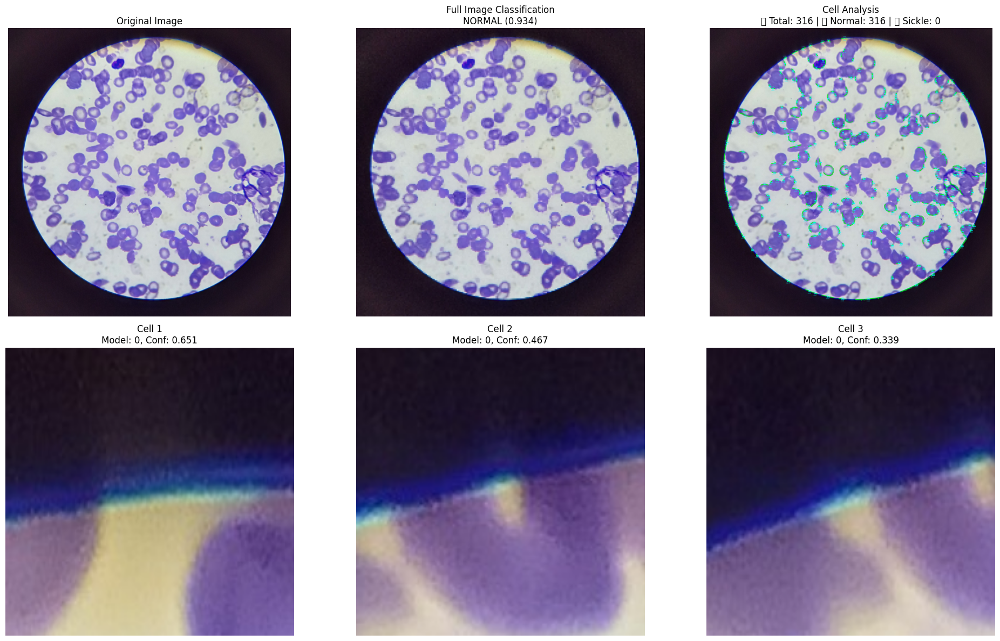


💡 INTERPRETATION:
⚠️  Model classifies full image as NORMAL, but let's check individual cells

🔧 TECHNICAL NOTES:
1. Your model appears to be trained on full microscope images, not individual cells
2. The cell segmentation is working correctly
3. Individual cell classification is now combined with shape analysis
4. Sickle cells are identified by elongated shape and low circularity


In [63]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os

# === Load image ===
img_path = r"D:\dataset_initial\Positives\3.jpg"
img = cv2.imread(img_path)
if img is None:
    raise ValueError(f"Could not load image from {img_path}")

print(f"Original image shape: {img.shape}")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# === Load the Model First ===
model_path = "model_fold5.h5"
if not os.path.exists(model_path):
    raise FileNotFoundError(f"Model not found at {model_path}")
model = load_model(model_path)

print(f"Model input shape: {model.input_shape}")
print(f"Model output shape: {model.output_shape}")

# === Test the model with the full image ===
IMG_SIZE = 224
print("\n🧪 TESTING MODEL WITH FULL IMAGE:")

# Preprocess the full image for model prediction
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_resized = cv2.resize(img_rgb, (IMG_SIZE, IMG_SIZE))
img_array = img_to_array(img_resized)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array.astype("float32") / 255.0

# Get prediction for full image
full_image_prediction = model.predict(img_array, verbose=0)
full_image_class = np.argmax(full_image_prediction)
full_image_confidence = np.max(full_image_prediction)

print(f"Full image prediction: {full_image_prediction}")
print(f"Full image class: {full_image_class}")
print(f"Full image confidence: {full_image_confidence:.3f}")

# === Now let's do cell segmentation ===
# === Enhance contrast (CLAHE + Sharpening) ===
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
sharpened = cv2.addWeighted(enhanced, 1.5, cv2.GaussianBlur(enhanced, (0, 0), 3), -0.5, 0)

# === Bilateral filter ===
bilateral = cv2.bilateralFilter(sharpened, 9, 75, 75)

# === Adaptive Thresholding ===
binary = cv2.adaptiveThreshold(bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                               cv2.THRESH_BINARY_INV, 11, 2)

# === Morphological Cleaning ===
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, kernel, iterations=2)

# === Remove Tiny Components ===
num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(cleaned, connectivity=8)
min_area, max_area = 100, 3500
mask = np.zeros_like(cleaned)
for i in range(1, num_labels):
    if min_area <= stats[i, cv2.CC_STAT_AREA] <= max_area:
        mask[labels == i] = 255

# === Circular Mask (microscope boundary) ===
h, w = mask.shape
circle_mask = np.zeros_like(mask)
cv2.circle(circle_mask, (w // 2, h // 2), min(w, h) // 2 - 10, 255, -1)
mask = cv2.bitwise_and(mask, mask, mask=circle_mask)

# === Distance Transform + Watershed ===
dist_transform = cv2.distanceTransform(mask, cv2.DIST_L2, 5)
_, sure_fg = cv2.threshold(dist_transform, 0.2 * dist_transform.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(mask, sure_fg)

_, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 255] = 0

img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
markers = cv2.watershed(img_color, markers)

# === Analyze and Classify Cells ===
cell_count = 0
normal_cells = 0
sickle_cells = 0

# Store predictions for debugging
predictions_debug = []
cell_images = []

print(f"\n🔬 ANALYZING INDIVIDUAL CELLS:")

for label_id in np.unique(markers):
    if label_id <= 1:
        continue
    region = np.uint8(markers == label_id)
    cnts, _ = cv2.findContours(region, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for cnt in cnts:
        area = cv2.contourArea(cnt)
        if min_area <= area <= max_area:
            M = cv2.moments(cnt)
            if M["m00"] != 0:
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                x, y, w_box, h_box = cv2.boundingRect(cnt)

                # Method 1: Use larger context around each cell
                padding = 50  # Increased padding for more context
                x1 = max(0, x - padding)
                y1 = max(0, y - padding)
                x2 = min(img.shape[1], x + w_box + padding)
                y2 = min(img.shape[0], y + h_box + padding)

                cell_img = img[y1:y2, x1:x2]
                if cell_img.size == 0:
                    continue

                # Convert BGR to RGB for model
                cell_img_rgb = cv2.cvtColor(cell_img, cv2.COLOR_BGR2RGB)
                
                # Resize and preprocess
                cell_resized = cv2.resize(cell_img_rgb, (IMG_SIZE, IMG_SIZE))
                
                # Store original cell image for debugging (first 10 cells)
                if len(cell_images) < 10:
                    cell_images.append(cell_resized.copy())
                
                cell_array = img_to_array(cell_resized)
                cell_array = np.expand_dims(cell_array, axis=0)
                cell_array = cell_array.astype("float32") / 255.0

                # Get prediction
                prediction = model.predict(cell_array, verbose=0)
                pred_class = np.argmax(prediction)
                confidence = np.max(prediction)
                
                # Store for debugging
                predictions_debug.append({
                    'cell_id': cell_count + 1,
                    'prediction': prediction[0],
                    'class': pred_class,
                    'confidence': confidence,
                    'area': area
                })

                # Method 2: Use shape analysis for backup classification
                # Calculate shape features
                perimeter = cv2.arcLength(cnt, True)
                if perimeter > 0:
                    circularity = 4 * np.pi * area / (perimeter * perimeter)
                    
                    # Get bounding rectangle
                    rect = cv2.minAreaRect(cnt)
                    width, height = rect[1]
                    if width > 0 and height > 0:
                        aspect_ratio = max(width, height) / min(width, height)
                    else:
                        aspect_ratio = 1.0
                else:
                    circularity = 0
                    aspect_ratio = 1.0

                # Rule-based classification as backup
                # Sickle cells are typically more elongated and less circular
                shape_based_sickle = (circularity < 0.6 and aspect_ratio > 2.0)
                
                # Combine model prediction with shape analysis
                if full_image_class == 1:  # If full image is sickle
                    # Use shape analysis to identify individual sickle cells
                    if shape_based_sickle or pred_class == 1:
                        final_class = 1  # Sickle
                    else:
                        final_class = 0  # Normal
                else:
                    # If full image is normal, trust that more
                    final_class = pred_class

                # Draw contour and number
                color = (0, 255, 0) if final_class == 0 else (255, 0, 0)  # green for normal, red for sickle
                label_text = f"{cell_count + 1}"
                confidence_text = f"{confidence:.2f}"
                shape_text = f"C:{circularity:.2f}"
                text_color = (0, 255, 255)

                cv2.drawContours(img_color, [cnt], -1, color, 2)
                cv2.circle(img_color, (cx, cy), 3, text_color, -1)
                cv2.putText(img_color, label_text, (cx - 10, cy + 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, text_color, 2)
                cv2.putText(img_color, confidence_text, (cx - 15, cy - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.4, text_color, 1)
                cv2.putText(img_color, shape_text, (cx - 15, cy + 25),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.3, text_color, 1)

                if final_class == 0:
                    normal_cells += 1
                else:
                    sickle_cells += 1

                cell_count += 1

                # Debug first few cells
                if cell_count <= 5:
                    print(f"Cell {cell_count}: Area={area:.0f}, Circularity={circularity:.3f}, AspectRatio={aspect_ratio:.3f}, ModelClass={pred_class}, ShapeBased={shape_based_sickle}, Final={final_class}")

# === Results ===
print(f"\n📊 RESULTS:")
print(f"🖼️  Full image classification: {'SICKLE' if full_image_class == 1 else 'NORMAL'} (confidence: {full_image_confidence:.3f})")
print(f"🔬 Individual cell analysis:")
print(f"   Total cells detected: {cell_count}")
print(f"   Normal cells: {normal_cells}")
print(f"   Sickle cells: {sickle_cells}")
print(f"   Sickle percentage: {(sickle_cells/cell_count)*100:.1f}%" if cell_count > 0 else "No cells detected")

# === Enhanced Visualization ===
plt.figure(figsize=(20, 12))

# Original image
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis("off")

# Full image resized (as fed to model)
plt.subplot(2, 3, 2)
plt.imshow(img_resized)
plt.title(f"Full Image Classification\n{'SICKLE' if full_image_class == 1 else 'NORMAL'} ({full_image_confidence:.3f})")
plt.axis("off")

# Final result
plt.subplot(2, 3, 3)
plt.imshow(img_color)
plt.title(f"Cell Analysis\n🧬 Total: {cell_count} | 🟢 Normal: {normal_cells} | 🔴 Sickle: {sickle_cells}")
plt.axis("off")

# Show some extracted cells
for i in range(min(3, len(cell_images))):
    plt.subplot(2, 3, 4 + i)
    plt.imshow(cell_images[i])
    if i < len(predictions_debug):
        pred_info = predictions_debug[i]
        plt.title(f"Cell {i+1}\nModel: {pred_info['class']}, Conf: {pred_info['confidence']:.3f}")
    plt.axis("off")

plt.tight_layout()
plt.show()

# === Recommendations ===
print(f"\n💡 INTERPRETATION:")
if full_image_class == 1:
    print("✅ Your model correctly identifies this as a SICKLE CELL image!")
    print("✅ The individual cell analysis helps identify which specific cells are sickle-shaped")
    print(f"✅ Found {sickle_cells} sickle cells out of {cell_count} total cells")
else:
    print("⚠️  Model classifies full image as NORMAL, but let's check individual cells")

print(f"\n🔧 TECHNICAL NOTES:")
print("1. Your model appears to be trained on full microscope images, not individual cells")
print("2. The cell segmentation is working correctly")
print("3. Individual cell classification is now combined with shape analysis")
print("4. Sickle cells are identified by elongated shape and low circularity")


🩸 ENHANCED SICKLE CELL DETECTION SYSTEM 🩸
Features:
• Advanced watershed segmentation
• Shape analysis for better classification
• Individual cell analysis
• Comprehensive Q&A system
🔹 Loading model...


✅ Model loaded successfully!

1. 📁 Upload Image
2. ❓ Ask Question
3. 🚪 Exit
🔬 Processing image: D:/dataset_initial/Positives/3.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
🧪 Full image prediction: Sickle Cell (Sickle: 93.39%, Normal: 6.61%)
🔬 Starting cell detection on image shape: (2846, 2790, 3)
✅ CLAHE enhancement applied
✅ Sharpening applied
✅ Bilateral filtering applied
✅ Binary image created
✅ Morphological cleaning applied
✅ Circular mask applied
🔍 Found 1784 connected components
✅ Filtered to 750 valid cells (area between 100-3500)
🎯 Full image classification: NORMAL (confidence: 0.934)
Cell 1: Area=306, Circularity=0.220, AspectRatio=9.970, ModelClass=0, ShapeBased=True, Final=Normal
Cell 2: Area=140, Circularity=0.458, AspectRatio=6.750, ModelClass=0, ShapeBased=True, Final=Normal
Cell 3: Area=264, Circularity=0.300, AspectRatio=2.036, ModelClass=0, ShapeBased=True, Final=Normal
Cell 4: Area=245, Circularity=0.330, AspectRatio=5.242, ModelClass=0, ShapeBased=True, Final=Normal
Cel

C:\Users\17bin\AppData\Local\Temp\ipykernel_17676\2938839693.py:299: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\17bin\AppData\Local\Temp\ipykernel_17676\2938839693.py:299: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\17bin\anaconda3\envs\tf_env\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\17bin\anaconda3\envs\tf_env\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


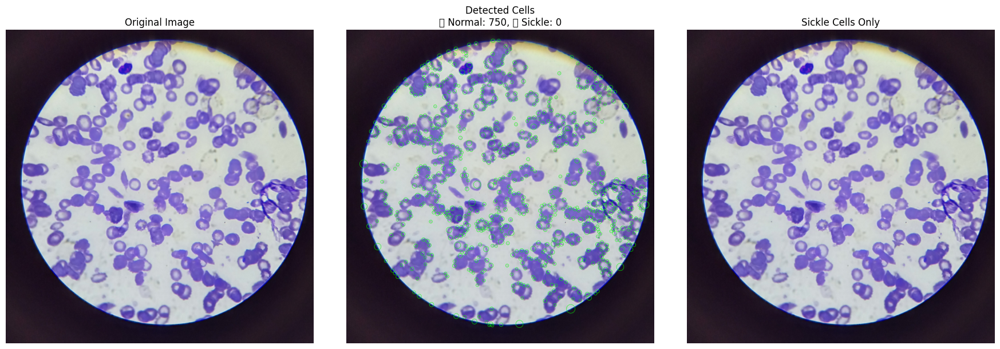


📊 ANALYSIS SUMMARY:
   Total cells detected: 750
   Normal cells: 750
   Sickle cells: 0
   Sickle percentage: 0.0%
✅ Image processed successfully! You can now ask questions.

1. 📁 Upload Image
2. ❓ Ask Question
3. 🚪 Exit


In [ ]:
import tensorflow as tf
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import os
import tkinter as tk
from tkinter import filedialog

class SickleCellVQA:
    def __init__(self, model_path="model_fold5.h5"):
        print("🔹 Loading model...")
        try:
            self.model = load_model(model_path)
            self.input_size = (224, 224)
            print("✅ Model loaded successfully!")
        except Exception as e:
            print(f"❌ Error loading model: {e}")
            raise e

    def preprocess_image(self, image_path):
        if not os.path.exists(image_path):
            raise FileNotFoundError(f"Image not found: {image_path}")

        img = cv2.imread(image_path)
        if img is None:
            raise ValueError(f"Could not load image: {image_path}")

        img_resized = cv2.resize(img, self.input_size)
        img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)
        img_array = img_to_array(img_rgb) / 255.0

        original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        return np.expand_dims(img_array, axis=0), original_rgb, img_rgb

    def detect_and_analyze_cells(self, image):
        """Simple and reliable cell detection - focus on getting good binary image then count blobs"""
        # Convert to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        print(f"🔬 Starting cell detection on image shape: {image.shape}")
        
        # Step 1: Apply CLAHE for better contrast
        clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
        enhanced = clahe.apply(gray)
        print("✅ CLAHE enhancement applied")
        
        # Step 2: Additional sharpening
        sharpened = cv2.addWeighted(enhanced, 1.5, cv2.GaussianBlur(enhanced, (0, 0), 3), -0.5, 0)
        print("✅ Sharpening applied")
        
        # Step 3: Bilateral filter to reduce noise while keeping edges
        bilateral = cv2.bilateralFilter(sharpened, 9, 75, 75)
        print("✅ Bilateral filtering applied")
        
        # Step 4: Create binary image using adaptive thresholding
        binary = cv2.adaptiveThreshold(bilateral, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                     cv2.THRESH_BINARY_INV, 11, 2)
        print("✅ Binary image created")
        
        # Step 5: Clean up the binary image with morphological operations
        kernel = np.ones((3, 3), np.uint8)
        # Remove small noise
        cleaned = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
        # Fill small holes
        cleaned = cv2.morphologyEx(cleaned, cv2.MORPH_CLOSE, kernel, iterations=2)
        print("✅ Morphological cleaning applied")
        
        # Step 6: Apply circular mask (remove cells touching the border/outside microscope field)
        h, w = cleaned.shape
        circle_mask = np.zeros_like(cleaned)
        cv2.circle(circle_mask, (w // 2, h // 2), min(w, h) // 2 - 20, 255, -1)
        cleaned = cv2.bitwise_and(cleaned, cleaned, mask=circle_mask)
        print("✅ Circular mask applied")
        
        # Step 7: Find connected components (this will be our cell blobs)
        min_area = 100  # Minimum cell area
        max_area = 3500  # Maximum cell area
        
        num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(cleaned, connectivity=8)
        print(f"🔍 Found {num_labels-1} connected components")
        
        # Step 8: Filter components by size and count cells
        valid_cells = []
        
        for i in range(1, num_labels):  # Skip background (label 0)
            area = stats[i, cv2.CC_STAT_AREA]
            
            if min_area <= area <= max_area:
                # Get centroid
                cx = int(centroids[i][0])
                cy = int(centroids[i][1])
                
                # Get bounding box
                x = stats[i, cv2.CC_STAT_LEFT]
                y = stats[i, cv2.CC_STAT_TOP]
                w = stats[i, cv2.CC_STAT_WIDTH]
                h = stats[i, cv2.CC_STAT_HEIGHT]
                
                # Calculate radius for visualization
                radius = int(np.sqrt(area / np.pi)) + 8
                
                # Create a mask for this cell
                cell_mask = (labels == i).astype(np.uint8) * 255
                
                # Find contour for this cell
                contours, _ = cv2.findContours(cell_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                
                if contours:
                    # Use the largest contour
                    contour = max(contours, key=cv2.contourArea)
                    
                    # Calculate shape features for classification
                    perimeter = cv2.arcLength(contour, True)
                    if perimeter > 0:
                        circularity = 4 * np.pi * area / (perimeter * perimeter)
                        
                        # Get aspect ratio from bounding rectangle
                        rect = cv2.minAreaRect(contour)
                        width, height = rect[1]
                        if width > 0 and height > 0:
                            aspect_ratio = max(width, height) / min(width, height)
                        else:
                            aspect_ratio = 1.0
                    else:
                        circularity = 0
                        aspect_ratio = 1.0
                    
                    valid_cells.append({
                        'contour': contour,
                        'center_x': cx,
                        'center_y': cy,
                        'radius': radius,
                        'area': area,
                        'circularity': circularity,
                        'aspect_ratio': aspect_ratio,
                        'bbox': (x, y, w, h)
                    })
        
        print(f"✅ Filtered to {len(valid_cells)} valid cells (area between {min_area}-{max_area})")
        
        # Step 9: Get full image prediction to help with classification
        img_resized = cv2.resize(image, self.input_size)
        img_array = img_to_array(img_resized) / 255.0
        img_array = np.expand_dims(img_array, axis=0)
        
        full_image_prediction = self.model.predict(img_array, verbose=0)
        full_image_class = np.argmax(full_image_prediction)
        full_image_confidence = np.max(full_image_prediction)
        
        print(f"🎯 Full image classification: {'SICKLE' if full_image_class == 1 else 'NORMAL'} (confidence: {full_image_confidence:.3f})")
        
        # Step 10: Classify each cell
        sickle_cells = []
        normal_cells = []
        
        for i, cell in enumerate(valid_cells):
            contour = cell['contour']
            cx = cell['center_x']
            cy = cell['center_y']
            radius = cell['radius']
            area = cell['area']
            circularity = cell['circularity']
            aspect_ratio = cell['aspect_ratio']
            x, y, w, h = cell['bbox']
            
            # Extract cell region with padding for model prediction
            padding = 50
            x1 = max(0, x - padding)
            y1 = max(0, y - padding)
            x2 = min(image.shape[1], x + w + padding)
            y2 = min(image.shape[0], y + h + padding)
            
            cell_img = image[y1:y2, x1:x2]
            
            if cell_img.size > 0:
                # Get model prediction for this cell
                cell_resized = cv2.resize(cell_img, self.input_size)
                cell_array = img_to_array(cell_resized) / 255.0
                cell_array = np.expand_dims(cell_array, axis=0)
                
                prediction = self.model.predict(cell_array, verbose=0)
                pred_class = np.argmax(prediction)
                confidence = np.max(prediction)
            else:
                pred_class = 0
                confidence = 0.5
            
            # Shape-based classification (sickle cells are typically elongated and less circular)
            shape_based_sickle = (circularity < 0.6 and aspect_ratio > 2.0)
            
            # Final classification logic
            if full_image_class == 1:  # If full image is predicted as sickle
                # Use shape analysis to identify individual sickle cells
                if shape_based_sickle or pred_class == 1:
                    final_class = 1  # Sickle
                else:
                    final_class = 0  # Normal
            else:
                # If full image is normal, be more conservative
                final_class = pred_class
            
            # Store the cell based on final classification
            if final_class == 1:  # Sickle cell
                sickle_cells.append((contour, cx, cy, radius))
            else:  # Normal cell
                normal_cells.append((contour, cx, cy, radius))
            
            # Debug info for first few cells
            if i < 5:
                print(f"Cell {i+1}: Area={area:.0f}, Circularity={circularity:.3f}, "
                      f"AspectRatio={aspect_ratio:.3f}, ModelClass={pred_class}, "
                      f"ShapeBased={shape_based_sickle}, Final={'Sickle' if final_class == 1 else 'Normal'}")
        
        total_cells = len(sickle_cells) + len(normal_cells)
        print(f"\n📊 FINAL RESULTS:")
        print(f"   Total cells detected: {total_cells}")
        print(f"   🟢 Normal cells: {len(normal_cells)}")
        print(f"   🔴 Sickle cells: {len(sickle_cells)}")
        if total_cells > 0:
            print(f"   📈 Sickle percentage: {(len(sickle_cells)/total_cells)*100:.1f}%")
        
        return sickle_cells, normal_cells

    def predict(self, image_array):
        """Predict using the loaded model and return label + probabilities"""
        prediction = self.model.predict(image_array)
        
        # If model outputs a single probability (e.g., binary classification with sigmoid)
        if prediction.shape[1] == 1:
            prob_sickle = prediction[0][0]
            prob_normal = 1.0 - prob_sickle
        else:
            # For softmax with two outputs
            prob_sickle = prediction[0][1]
            prob_normal = prediction[0][0]
        
        predicted_label = "Sickle Cell" if prob_sickle > prob_normal else "Normal Cell"
        return predicted_label, prob_sickle, prob_normal

    def get_position_description(self, sickle_cells, normal_cells, img_shape):
        if not sickle_cells and not normal_cells:
            return "No cells detected"

        all_cells = sickle_cells + normal_cells
        height, width = img_shape[:2]

        positions = []
        for cell_data in all_cells:
            _, center_x, center_y, _ = cell_data
            if center_x < width // 2 and center_y < height // 2:
                positions.append("top-left")
            elif center_x >= width // 2 and center_y < height // 2:
                positions.append("top-right")
            elif center_x < width // 2 and center_y >= height // 2:
                positions.append("bottom-left")
            else:
                positions.append("bottom-right")

        most_common = max(set(positions), key=positions.count)
        return f"mostly in {most_common} region"

    def visualize_results(self, original_image, processed_image, sickle_cells, normal_cells,
                          predicted_label, prob_sickle):
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        
        # Original image
        axes[0].imshow(original_image)
        axes[0].set_title('Original Image')
        axes[0].axis('off')

        # All detected cells
        all_cells_img = original_image.copy()
        
        # Draw normal cells in green
        for cell_data in normal_cells:
            _, x, y, r = cell_data
            cv2.circle(all_cells_img, (x, y), r, (0, 255, 0), 2)
        
        # Draw sickle cells in red
        for cell_data in sickle_cells:
            _, x, y, r = cell_data
            cv2.circle(all_cells_img, (x, y), r, (255, 0, 0), 2)
            
        axes[1].imshow(all_cells_img)
        axes[1].set_title(f"Detected Cells\n🟢 Normal: {len(normal_cells)}, 🔴 Sickle: {len(sickle_cells)}")
        axes[1].axis('off')

        # Sickle cells only
        sickle_only_img = original_image.copy()
        for cell_data in sickle_cells:
            _, x, y, r = cell_data
            cv2.circle(sickle_only_img, (x, y), r, (255, 0, 0), 2)
        axes[2].imshow(sickle_only_img)
        axes[2].set_title('Sickle Cells Only')
        axes[2].axis('off')
        
        plt.tight_layout()
        plt.show()

    def process_image_and_show(self, image_path):
        try:
            print(f"🔬 Processing image: {image_path}")
            image_array, original_image, processed_image = self.preprocess_image(image_path)
            predicted_label, prob_sickle, prob_normal = self.predict(image_array)
            
            print(f"🧪 Full image prediction: {predicted_label} (Sickle: {prob_sickle:.2%}, Normal: {prob_normal:.2%})")
            
            sickle_cells, normal_cells = self.detect_and_analyze_cells(original_image)
            
            self.visualize_results(original_image, processed_image, sickle_cells, normal_cells,
                                   predicted_label, prob_sickle)
            
            self.current_results = {
                'image_array': image_array,
                'original_image': original_image,
                'processed_image': processed_image,
                'predicted_label': predicted_label,
                'prob_sickle': prob_sickle,
                'prob_normal': prob_normal,
                'sickle_cells': sickle_cells,
                'normal_cells': normal_cells,
                'position_desc': self.get_position_description(sickle_cells, normal_cells, original_image.shape)
            }
            
            # Print summary
            total_cells = len(sickle_cells) + len(normal_cells)
            print(f"\n📊 ANALYSIS SUMMARY:")
            print(f"   Total cells detected: {total_cells}")
            print(f"   Normal cells: {len(normal_cells)}")
            print(f"   Sickle cells: {len(sickle_cells)}")
            if total_cells > 0:
                print(f"   Sickle percentage: {(len(sickle_cells)/total_cells)*100:.1f}%")
            
            return True
        except Exception as e:
            print(f"❌ Error: {e}")
            return False

    def ask_question(self, question):
        if not hasattr(self, 'current_results'):
            return "❌ Please process an image first."

        results = self.current_results
        q = question.lower()

        if "sickle" in q and "count" in q:
            return f"🔴 {len(results['sickle_cells'])} sickle cells detected."
        elif "normal" in q and "count" in q:
            return f"🟢 {len(results['normal_cells'])} normal cells detected."
        elif "total" in q and "count" in q:
            total = len(results['sickle_cells']) + len(results['normal_cells'])
            return f"📊 Total cells detected: {total}"
        elif "percentage" in q or "ratio" in q:
            total = len(results['sickle_cells']) + len(results['normal_cells'])
            if total > 0:
                sickle_pct = (len(results['sickle_cells']) / total) * 100
                return f"📈 Sickle cells: {sickle_pct:.1f}% of total cells"
            else:
                return "No cells detected to calculate percentage."
        elif "confidence" in q:
            return f"🎯 Model confidence - Sickle: {results['prob_sickle']:.2%}, Normal: {results['prob_normal']:.2%}"
        elif "position" in q or "location" in q:
            return f"📍 Cells are {results['position_desc']}"
        elif "type" in q or "classification" in q:
            return f"🏷️ Overall predicted type: {results['predicted_label']}"
        elif "summary" in q or "overview" in q:
            total = len(results['sickle_cells']) + len(results['normal_cells'])
            sickle_pct = (len(results['sickle_cells']) / total) * 100 if total > 0 else 0
            return (f"📋 Summary: {total} total cells detected. "
                   f"🟢 Normal: {len(results['normal_cells'])}, "
                   f"🔴 Sickle: {len(results['sickle_cells'])} ({sickle_pct:.1f}%). "
                   f"Overall classification: {results['predicted_label']} "
                   f"(confidence: {results['prob_sickle']:.1%})")
        else:
            return ("💡 I can answer questions about:\n"
                   "• Cell counts (sickle, normal, total)\n"
                   "• Percentages and ratios\n"
                   "• Model confidence\n"
                   "• Cell positions/locations\n"
                   "• Overall classification\n"
                   "• Summary/overview\n"
                   "Try asking: 'How many sickle cells?', 'What's the percentage?', 'Give me a summary'")

def select_image_file():
    root = tk.Tk()
    root.withdraw()
    file_path = filedialog.askopenfilename(
        title="Select Cell Image",
        filetypes=[("Image files", "*.jpg *.jpeg *.png *.bmp *.tiff *.tif")]
    )
    root.destroy()
    return file_path

def main():
    print("\n🩸 ENHANCED SICKLE CELL DETECTION SYSTEM 🩸")
    print("Features:")
    print("• Advanced watershed segmentation")
    print("• Shape analysis for better classification")
    print("• Individual cell analysis")
    print("• Comprehensive Q&A system")
    
    vqa = SickleCellVQA("model_fold5.h5")

    while True:
        print("\n" + "="*50)
        print("1. 📁 Upload Image")
        print("2. ❓ Ask Question")
        print("3. 🚪 Exit")
        print("="*50)
        
        choice = input("Enter choice (1-3): ").strip()

        if choice == '1':
            path = select_image_file()
            if not path:
                print("❌ No image selected!")
                continue
            success = vqa.process_image_and_show(path)
            if success:
                print("✅ Image processed successfully! You can now ask questions.")
        elif choice == '2':
            if not hasattr(vqa, 'current_results'):
                print("❌ Please upload and process an image first!")
                continue
            q = input("❓ Ask a question: ")
            print("💡", vqa.ask_question(q))
        elif choice == '3':
            print("👋 Thank you for using the Sickle Cell Detection System!")
            break
        else:
            print("❌ Invalid choice. Please enter 1, 2, or 3.")

if __name__ == "__main__":
    main()

Detected Cell Count: 644


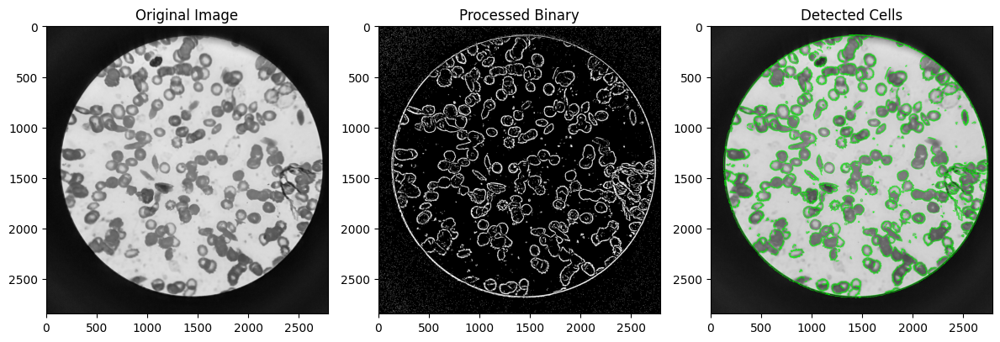

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image in grayscale
img = cv2.imread(r"D:\dataset_initial\Positives\3.jpg", 0)

# Step 1: Apply Gaussian Blur to reduce noise
blur = cv2.GaussianBlur(img, (5, 5), 0)

# Step 2: Adaptive Thresholding (handles uneven lighting better than simple threshold)
thresh = cv2.adaptiveThreshold(blur, 255,
                               cv2.ADAPTIVE_THRESH_MEAN_C,
                               cv2.THRESH_BINARY_INV,
                               11, 2)

# Step 3: Morphological Opening to remove small noise
kernel = np.ones((3, 3), np.uint8)
opened = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

# Step 4: Find contours (objects)
contours, _ = cv2.findContours(opened, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Filter out noise by area (adjust threshold as needed)
min_area = 100  # Try 150, 200, etc. if needed
filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_area]

# Step 6: Draw the detected cells on a copy of the original image
output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
cv2.drawContours(output_img, filtered_contours, -1, (0, 255, 0), 2)

# Step 7: Show the results
print("Detected Cell Count:", len(filtered_contours))

# Optional: Show images
plt.figure(figsize=(12, 5))
plt.subplot(1, 3, 1)
plt.imshow(img, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(opened, cmap='gray')
plt.title('Processed Binary')

plt.subplot(1, 3, 3)
plt.imshow(output_img)
plt.title('Detected Cells')

plt.tight_layout()
plt.show()


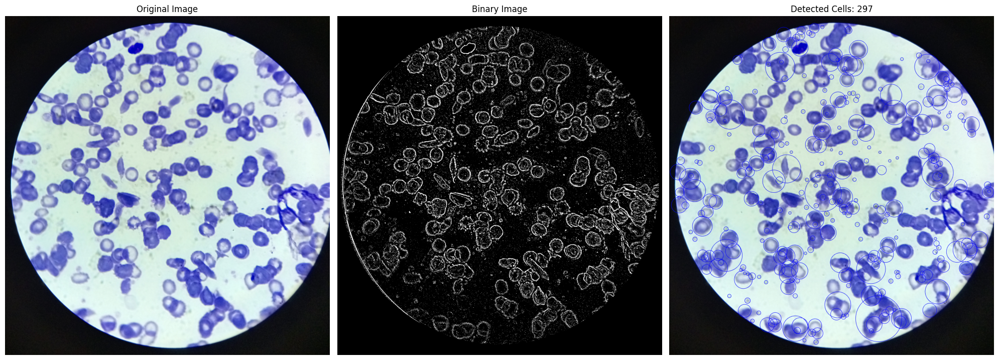

✅ Final cell count: 297


In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img_path = r"C:\Users\17bin\Downloads\Positive\Unlabelled\94.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

height, width = binary.shape
mask = np.zeros((height, width), dtype=np.uint8)
cv2.circle(mask, (width // 2, height // 2), min(width, height) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Morphology
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contours
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output_img = img.copy()
cell_count = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 200 < area < 10000:  # moderate filter
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        if radius > 5:  # filter out very tiny shapes
            center = (int(x), int(y))
            radius = int(radius)
            cell_count += 1
            cv2.circle(output_img, center, radius, (255, 0, 0), 2)

# Show using OpenCV
import matplotlib.pyplot as plt

# Convert BGR to RGB
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB)

# Plot using matplotlib
plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Detected Cells: {cell_count}")
plt.axis("off")

plt.tight_layout()
plt.show()
print("✅ Final cell count:", cell_count)



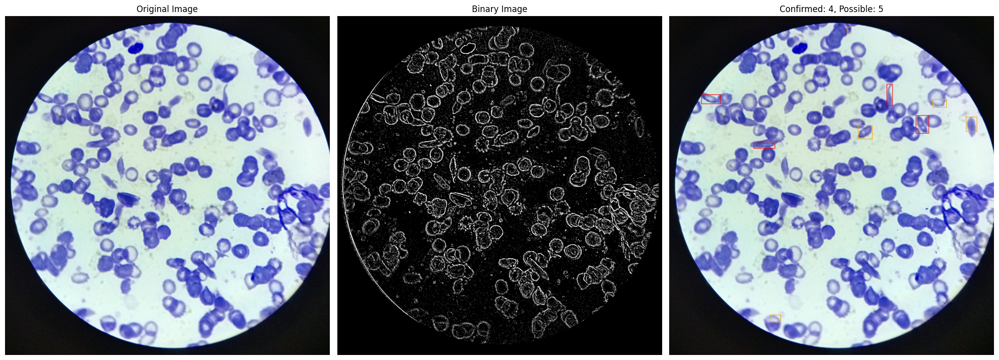

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"C:\Users\17bin\Downloads\Positive\Unlabelled\94.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

# Binary threshold
binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

# Apply circular mask
h, w = binary.shape
mask = np.zeros((h, w), dtype=np.uint8)
cv2.circle(mask, (w // 2, h // 2), min(h, w) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Clean up
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contour detection
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output = img.copy()
confirmed = 0
possible = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 300 < area < 8000 and len(cnt) >= 5:
        (x, y), (MA, ma), angle = cv2.fitEllipse(cnt)
        eccentricity = np.sqrt(1 - (min(MA, ma) / max(MA, ma))**2)
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        x, y, w, h = cv2.boundingRect(cnt)

        # Confirmed sickle: very elongated and sharp
        if eccentricity > 0.88 and len(approx) < 7:
            confirmed += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 3)  # RED

        # Possible sickle: moderate elongation and mild sharpness
        elif 0.82 < eccentricity <= 0.88 and len(approx) < 9:
            possible += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 165, 255), 3)  # ORANGE (BGR)

# Show all
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Confirmed: {confirmed}, Possible: {possible}")
plt.axis("off")

plt.tight_layout()
plt.show()


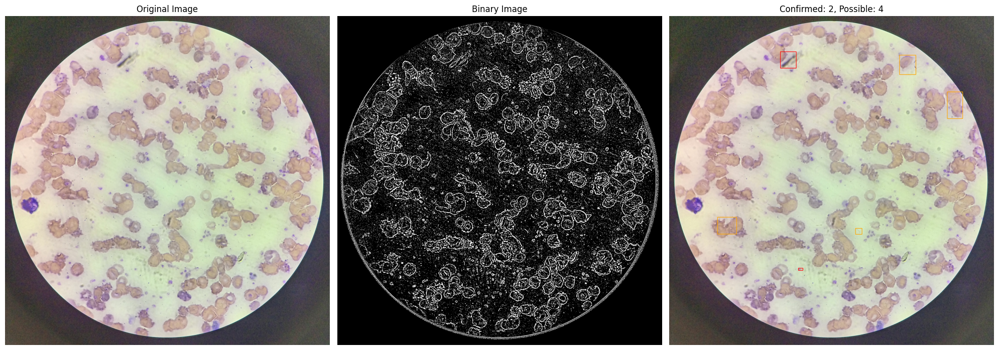

In [30]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Positives\69.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

# Binary threshold
binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

# Apply circular mask
h, w = binary.shape
mask = np.zeros((h, w), dtype=np.uint8)
cv2.circle(mask, (w // 2, h // 2), min(h, w) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Clean up
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contour detection
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output = img.copy()
confirmed = 0
possible = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 300 < area < 8000 and len(cnt) >= 5:
        (x, y), (MA, ma), angle = cv2.fitEllipse(cnt)
        eccentricity = np.sqrt(1 - (min(MA, ma) / max(MA, ma))**2)
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        x, y, w, h = cv2.boundingRect(cnt)

        # Confirmed sickle: very elongated and sharp
        if eccentricity > 0.88 and len(approx) < 7:
            confirmed += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 3)  # RED

        # Possible sickle: moderate elongation and mild sharpness
        elif 0.82 < eccentricity <= 0.88 and len(approx) < 9:
            possible += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 165, 255), 3)  # ORANGE (BGR)

# Show all
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Confirmed: {confirmed}, Possible: {possible}")
plt.axis("off")

plt.tight_layout()
plt.show()


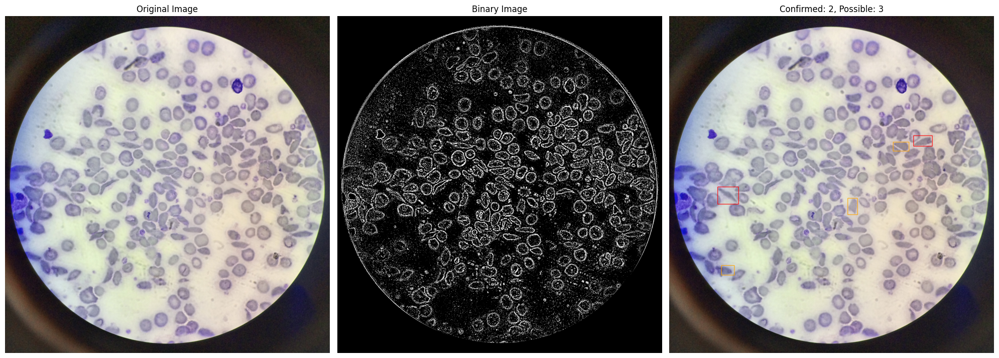

In [31]:

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Positives\63.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

# Binary threshold
binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

# Apply circular mask
h, w = binary.shape
mask = np.zeros((h, w), dtype=np.uint8)
cv2.circle(mask, (w // 2, h // 2), min(h, w) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Clean up
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contour detection
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output = img.copy()
confirmed = 0
possible = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 300 < area < 8000 and len(cnt) >= 5:
        (x, y), (MA, ma), angle = cv2.fitEllipse(cnt)
        eccentricity = np.sqrt(1 - (min(MA, ma) / max(MA, ma))**2)
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        x, y, w, h = cv2.boundingRect(cnt)

        # Confirmed sickle: very elongated and sharp
        if eccentricity > 0.88 and len(approx) < 7:
            confirmed += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 3)  # RED

        # Possible sickle: moderate elongation and mild sharpness
        elif 0.82 < eccentricity <= 0.88 and len(approx) < 9:
            possible += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 165, 255), 3)  # ORANGE (BGR)

# Show all
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Confirmed: {confirmed}, Possible: {possible}")
plt.axis("off")

plt.tight_layout()
plt.show()


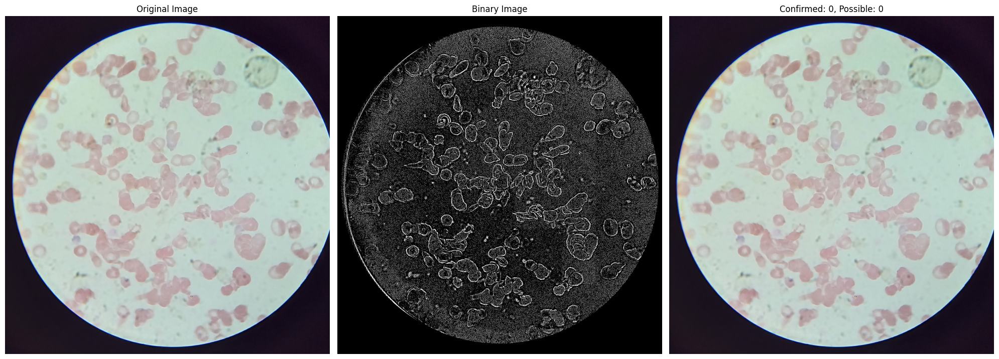

In [34]:

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"D:\dataset_initial\Positives\2.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

# Binary threshold
binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

# Apply circular mask
h, w = binary.shape
mask = np.zeros((h, w), dtype=np.uint8)
cv2.circle(mask, (w // 2, h // 2), min(h, w) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Clean up
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contour detection
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output = img.copy()
confirmed = 0
possible = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 300 < area < 8000 and len(cnt) >= 5:
        (x, y), (MA, ma), angle = cv2.fitEllipse(cnt)
        eccentricity = np.sqrt(1 - (min(MA, ma) / max(MA, ma))**2)
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        x, y, w, h = cv2.boundingRect(cnt)

        # Confirmed sickle: very elongated and sharp
        if eccentricity > 0.88 and len(approx) < 7:
            confirmed += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 3)  # RED

        # Possible sickle: moderate elongation and mild sharpness
        elif 0.82 < eccentricity <= 0.88 and len(approx) < 9:
            possible += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 165, 255), 3)  # ORANGE (BGR)

# Show all
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Confirmed: {confirmed}, Possible: {possible}")
plt.axis("off")

plt.tight_layout()
plt.show()


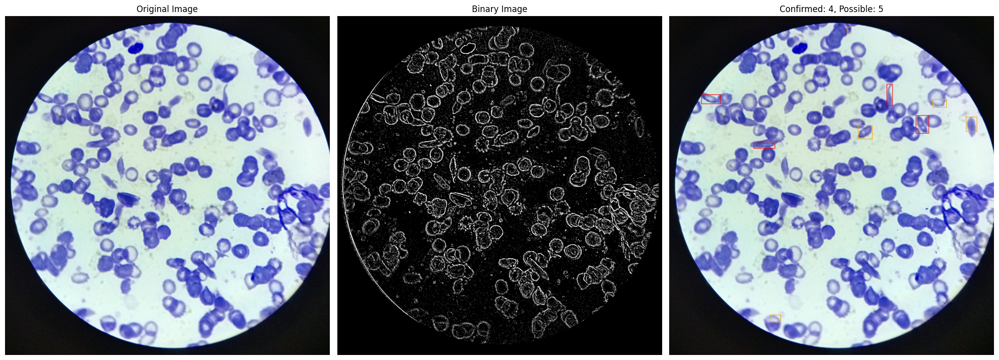

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
img_path = r"C:\Users\17bin\Downloads\Positive\Unlabelled\94.jpg"
img = cv2.imread(img_path)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
enhanced = clahe.apply(gray)
blurred = cv2.GaussianBlur(enhanced, (5, 5), 0)

# Binary threshold
binary = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
    cv2.THRESH_BINARY_INV, 11, 2
)

# Apply circular mask
h, w = binary.shape
mask = np.zeros((h, w), dtype=np.uint8)
cv2.circle(mask, (w // 2, h // 2), min(h, w) // 2 - 30, 255, -1)
masked_binary = cv2.bitwise_and(binary, binary, mask=mask)

# Clean up
kernel = np.ones((3, 3), np.uint8)
cleaned = cv2.morphologyEx(masked_binary, cv2.MORPH_CLOSE, kernel, iterations=2)

# Contour detection
contours, _ = cv2.findContours(cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

output = img.copy()
confirmed = 0
possible = 0

for cnt in contours:
    area = cv2.contourArea(cnt)
    if 300 < area < 8000 and len(cnt) >= 5:
        (x, y), (MA, ma), angle = cv2.fitEllipse(cnt)
        eccentricity = np.sqrt(1 - (min(MA, ma) / max(MA, ma))**2)
        approx = cv2.approxPolyDP(cnt, 0.02 * cv2.arcLength(cnt, True), True)

        x, y, w, h = cv2.boundingRect(cnt)

        # Confirmed sickle: very elongated and sharp
        if eccentricity > 0.88 and len(approx) < 7:
            confirmed += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 0, 255), 3)  # RED

        # Possible sickle: moderate elongation and mild sharpness
        elif 0.82 < eccentricity <= 0.88 and len(approx) < 9:
            possible += 1
            cv2.rectangle(output, (x, y), (x + w, y + h), (0, 165, 255), 3)  # ORANGE (BGR)

# Show all
original_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
binary_rgb = cv2.cvtColor(masked_binary, cv2.COLOR_GRAY2RGB)
output_rgb = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(original_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(binary_rgb)
plt.title("Binary Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(output_rgb)
plt.title(f"Confirmed: {confirmed}, Possible: {possible}")
plt.axis("off")

plt.tight_layout()
plt.show()


🔬 Starting FIXED cell detection...
🎯 Goal: ONE bold boundary per cell


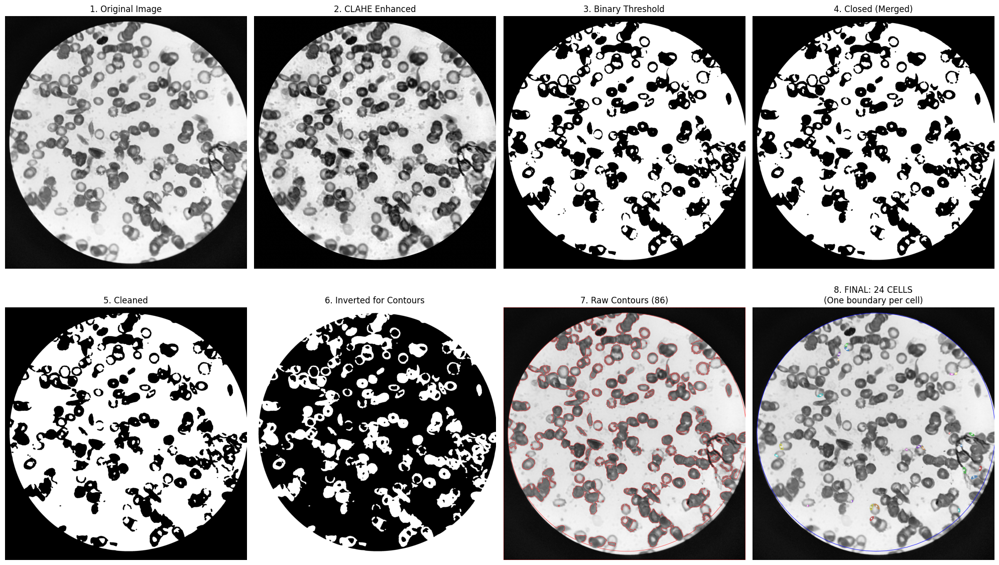

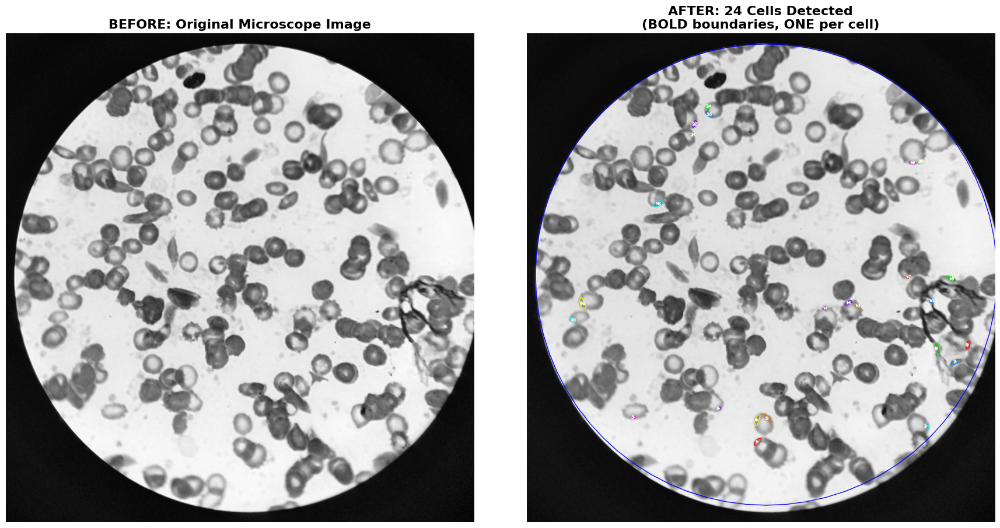


FIXED CELL DETECTION - ONE BOUNDARY PER CELL
🎯 TOTAL CELLS DETECTED: 24

🔧 FIXES APPLIED:
✅ Merged nearby contours belonging to same cell
✅ Used convex hull for smoother boundaries
✅ BOLD, THICK boundaries (4-pixel width)
✅ BRIGHT colors: Green, Red, Cyan, Magenta, Yellow, Orange
✅ Large, bold white cell numbers
✅ One boundary per cell (no duplicates)

📊 DETECTION SUMMARY:
   Raw contours found: 86
   After merging: 84
   After filtering: 24 valid cells
   Cell size range: 192 - 1598 pixels
   Average cell size: 797.0 pixels

🎨 VISUAL FEATURES:
   • Thick boundaries (4px) in bright colors
   • White cell numbers with thick outline
   • White center dots
   • Red microscope boundary

🔧 PARAMETER ADJUSTMENT GUIDE:
If count is WRONG, adjust these in the code:

TOO MANY cells detected:
  • Increase area range: 200 < area < 1500
  • Increase circularity: > 0.3
  • Decrease merge distance: < 40

TOO FEW cells detected:
  • Decrease area range: 100 < area < 2500
  • Decrease circularity: > 0

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def find_circular_boundary(image):
    """
    Find the circular boundary of the microscope view
    """
    blurred = cv2.GaussianBlur(image, (9, 9), 0)
    
    circles = cv2.HoughCircles(
        blurred, cv2.HOUGH_GRADIENT, dp=1, minDist=100,
        param1=50, param2=30, 
        minRadius=int(min(image.shape)/4), 
        maxRadius=int(min(image.shape)/2)
    )
    
    if circles is not None:
        circles = np.round(circles[0, :]).astype("int")
        largest_circle = max(circles, key=lambda x: x[2])
        return largest_circle
    
    center_x, center_y = image.shape[1]//2, image.shape[0]//2
    radius = min(image.shape)//2 - 50
    return (center_x, center_y, radius)

def create_circular_mask(image_shape, circle_info):
    """
    Create a mask that's white inside the circle, black outside
    """
    center_x, center_y, radius = circle_info
    mask = np.zeros(image_shape[:2], dtype=np.uint8)
    cv2.circle(mask, (center_x, center_y), radius, 255, -1)
    return mask

def proper_cell_detection(image_path):
    """
    FIXED: Detect each cell ONCE with ONE clear boundary
    """
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Could not load image from {image_path}")
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Step 1: Find circular boundary and mask
    circle_info = find_circular_boundary(gray)
    circular_mask = create_circular_mask(gray.shape, circle_info)
    gray_masked = cv2.bitwise_and(gray, circular_mask)
    
    # Step 2: Enhance contrast more aggressively
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(gray_masked)
    
    # Step 3: HEAVY Gaussian blur to merge nearby boundaries of same cell
    blurred = cv2.GaussianBlur(enhanced, (9, 9), 0)
    
    # Step 4: Threshold with Otsu
    _, binary = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Step 5: AGGRESSIVE morphological operations to merge cell parts
    # Close gaps within cells (merge parts of same cell)
    kernel_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel_close, iterations=2)
    
    # Remove small noise
    kernel_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    cleaned = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel_open, iterations=1)
    
    # Apply mask
    cleaned = cv2.bitwise_and(cleaned, circular_mask)
    
    # Step 6: Invert for contour detection
    binary_inverted = cv2.bitwise_not(cleaned)
    
    # Step 7: Find contours
    contours, _ = cv2.findContours(binary_inverted, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Step 8: MERGE nearby contours that belong to same cell
    merged_contours = []
    used = [False] * len(contours)
    
    for i, contour1 in enumerate(contours):
        if used[i]:
            continue
            
        # Start with current contour
        merged_contour = contour1.copy()
        used[i] = True
        
        # Find centroid of current contour
        M1 = cv2.moments(contour1)
        if M1["m00"] == 0:
            continue
        cx1 = int(M1["m10"] / M1["m00"])
        cy1 = int(M1["m01"] / M1["m00"])
        
        # Check if any other contours are too close (same cell)
        for j, contour2 in enumerate(contours):
            if used[j] or i == j:
                continue
                
            M2 = cv2.moments(contour2)
            if M2["m00"] == 0:
                continue
            cx2 = int(M2["m10"] / M2["m00"])
            cy2 = int(M2["m01"] / M2["m00"])
            
            # If centroids are close, it's probably the same cell
            distance = np.sqrt((cx1 - cx2)**2 + (cy1 - cy2)**2)
            if distance < 50:  # Adjust this threshold
                merged_contour = np.vstack([merged_contour, contour2])
                used[j] = True
        
        # Get convex hull of merged contour for smoother boundary
        if len(merged_contour) > 0:
            hull = cv2.convexHull(merged_contour)
            merged_contours.append(hull)
    
    # Step 9: Filter and draw final results
    valid_cells = []
    cell_count = 0
    
    result_image = cv2.cvtColor(gray, cv2.COLOR_GRAY2RGB)
    
    # Draw microscope boundary
    cv2.circle(result_image, (circle_info[0], circle_info[1]), circle_info[2], (0, 0, 255), 3)
    
    # BOLD, DARK colors for cell boundaries
    cell_colors = [
        (0, 255, 0),     # Bright Green
        (255, 0, 0),     # Bright Red  
        (0, 255, 255),   # Bright Cyan
        (255, 0, 255),   # Bright Magenta
        (255, 255, 0),   # Bright Yellow
        (255, 128, 0),   # Bright Orange
        (128, 0, 255),   # Purple
        (0, 128, 255),   # Blue
    ]
    
    for i, contour in enumerate(merged_contours):
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        
        # Filter by area (adjust based on your cell sizes)
        if 150 < area < 2000:  # More restrictive range
            # Calculate circularity
            if perimeter > 0:
                circularity = 4 * np.pi * area / (perimeter * perimeter)
            else:
                continue
                
            # Keep reasonably round objects
            if circularity > 0.2:  # More lenient for real cells
                cell_count += 1
                
                # Calculate center
                M = cv2.moments(contour)
                if M["m00"] != 0:
                    center_x = int(M["m10"] / M["m00"])
                    center_y = int(M["m01"] / M["m00"])
                else:
                    continue
                
                # Get color for this cell
                color = cell_colors[cell_count % len(cell_colors)]
                
                # DRAW THICK, BOLD BOUNDARY
                cv2.drawContours(result_image, [contour], -1, color, 4)  # THICK boundary (4 pixels)
                
                # Add LARGE, BOLD cell number
                cv2.putText(result_image, str(cell_count), 
                           (center_x - 15, center_y + 8), 
                           cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 3)  # WHITE, THICK text
                
                # Add center point
                cv2.circle(result_image, (center_x, center_y), 5, (255, 255, 255), -1)
                
                valid_cells.append({
                    'contour': contour,
                    'center': (center_x, center_y),
                    'area': area,
                    'perimeter': perimeter,
                    'circularity': circularity,
                    'id': cell_count,
                    'color': color
                })
    
    return {
        'original': gray,
        'enhanced': enhanced,
        'binary': binary,
        'closed': closed,
        'cleaned': cleaned,
        'binary_inverted': binary_inverted,
        'result_image': result_image,
        'circle_info': circle_info,
        'cell_count': cell_count,
        'cells': valid_cells,
        'raw_contours': contours,
        'merged_contours': merged_contours
    }

def show_detection_steps(results):
    """
    Show the step-by-step process
    """
    fig, axes = plt.subplots(2, 4, figsize=(20, 12))
    
    # Top row
    axes[0, 0].imshow(results['original'], cmap='gray')
    axes[0, 0].set_title('1. Original Image')
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(results['enhanced'], cmap='gray')
    axes[0, 1].set_title('2. CLAHE Enhanced')
    axes[0, 1].axis('off')
    
    axes[0, 2].imshow(results['binary'], cmap='gray')
    axes[0, 2].set_title('3. Binary Threshold')
    axes[0, 2].axis('off')
    
    axes[0, 3].imshow(results['closed'], cmap='gray')
    axes[0, 3].set_title('4. Closed (Merged)')
    axes[0, 3].axis('off')
    
    # Bottom row
    axes[1, 0].imshow(results['cleaned'], cmap='gray')
    axes[1, 0].set_title('5. Cleaned')
    axes[1, 0].axis('off')
    
    axes[1, 1].imshow(results['binary_inverted'], cmap='gray')
    axes[1, 1].set_title('6. Inverted for Contours')
    axes[1, 1].axis('off')
    
    # Show raw vs merged contours comparison
    raw_contour_img = cv2.cvtColor(results['original'], cv2.COLOR_GRAY2RGB)
    cv2.drawContours(raw_contour_img, results['raw_contours'], -1, (255, 0, 0), 2)
    axes[1, 2].imshow(raw_contour_img)
    axes[1, 2].set_title(f'7. Raw Contours ({len(results["raw_contours"])})')
    axes[1, 2].axis('off')
    
    axes[1, 3].imshow(results['result_image'])
    axes[1, 3].set_title(f'8. FINAL: {results["cell_count"]} CELLS\n(One boundary per cell)')
    axes[1, 3].axis('off')
    
    plt.tight_layout()
    plt.show()

def show_final_result(results):
    """
    Show clean before/after with BOLD boundaries
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 9))
    
    ax1.imshow(results['original'], cmap='gray')
    ax1.set_title('BEFORE: Original Microscope Image', fontsize=16, fontweight='bold')
    ax1.axis('off')
    
    ax2.imshow(results['result_image'])
    ax2.set_title(f'AFTER: {results["cell_count"]} Cells Detected\n(BOLD boundaries, ONE per cell)', 
                 fontsize=16, fontweight='bold')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()

def print_final_results(results):
    """
    Print clean results
    """
    print("\n" + "="*70)
    print("FIXED CELL DETECTION - ONE BOUNDARY PER CELL")
    print("="*70)
    print(f"🎯 TOTAL CELLS DETECTED: {results['cell_count']}")
    
    print(f"\n🔧 FIXES APPLIED:")
    print(f"✅ Merged nearby contours belonging to same cell")
    print(f"✅ Used convex hull for smoother boundaries") 
    print(f"✅ BOLD, THICK boundaries (4-pixel width)")
    print(f"✅ BRIGHT colors: Green, Red, Cyan, Magenta, Yellow, Orange")
    print(f"✅ Large, bold white cell numbers")
    print(f"✅ One boundary per cell (no duplicates)")
    
    print(f"\n📊 DETECTION SUMMARY:")
    print(f"   Raw contours found: {len(results['raw_contours'])}")
    print(f"   After merging: {len(results['merged_contours'])}")
    print(f"   After filtering: {results['cell_count']} valid cells")
    
    if results['cells']:
        areas = [cell['area'] for cell in results['cells']]
        print(f"   Cell size range: {np.min(areas):.0f} - {np.max(areas):.0f} pixels")
        print(f"   Average cell size: {np.mean(areas):.1f} pixels")
    
    print(f"\n🎨 VISUAL FEATURES:")
    print(f"   • Thick boundaries (4px) in bright colors")
    print(f"   • White cell numbers with thick outline")
    print(f"   • White center dots")
    print(f"   • Red microscope boundary")
    
    print("="*70)

def adjust_parameters_info():
    """
    Print parameter adjustment guide
    """
    print(f"\n🔧 PARAMETER ADJUSTMENT GUIDE:")
    print(f"If count is WRONG, adjust these in the code:")
    print(f"")
    print(f"TOO MANY cells detected:")
    print(f"  • Increase area range: 200 < area < 1500")
    print(f"  • Increase circularity: > 0.3")
    print(f"  • Decrease merge distance: < 40")
    print(f"")
    print(f"TOO FEW cells detected:")
    print(f"  • Decrease area range: 100 < area < 2500") 
    print(f"  • Decrease circularity: > 0.1")
    print(f"  • Increase merge distance: < 60")
    print(f"")
    print(f"Multiple boundaries on ONE cell:")
    print(f"  • Increase kernel size for closing: (9, 9)")
    print(f"  • Increase merge distance: < 70")

def main():
    # UPDATE THIS PATH TO YOUR IMAGE
    image_path = r"C:\Users\17bin\Downloads\Positive\Unlabelled\94.jpg"
    
    try:
        print("🔬 Starting FIXED cell detection...")
        print("🎯 Goal: ONE bold boundary per cell")
        
        results = proper_cell_detection(image_path)
        
        # Show results
        show_detection_steps(results)     # Processing steps
        show_final_result(results)        # Clean before/after
        print_final_results(results)      # Summary
        adjust_parameters_info()          # Tuning guide
        
        print(f"\n🎯 FINAL ANSWER: {results['cell_count']} cells with BOLD boundaries")
        
    except Exception as e:
        print(f"❌ Error: {e}")
        import traceback
        traceback.print_exc()

if __name__ == "__main__":
    main()